In [ ]:
import os
import glob
# import xml.etree.ElementTree as ET
import pandas as pd
!pip install "opencv-python-headless<4.3"
import csv
import cv2

     |████████████████████████████████| 21.6 MB 1.2 MB/s 


In [ ]:
# Clone tensorflow models repository
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3470, done.
remote: Counting objects: 100% (3470/3470), done.
remote: Compressing objects: 100% (2773/2773), done.
remote: Total 3470 (delta 1035), reused 1533 (delta 648), pack-reused 0
Receiving objects: 100% (3470/3470), 34.32 MiB | 22.78 MiB/s, done.
Resolving deltas: 100% (1035/1035), done.


In [ ]:
#get dataset
from google.colab import files
from google.colab import drive
drive.mount("/content/drive")
gdrive_path = "/content/drive/MyDrive/GarbageClassification/dataset_withO/"

Mounted at /content/drive


In [ ]:
#change the pipeline
pipeline_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model/pipeline.config'
model_path = '/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/SSD_MobileNet_v2'
num_classes = 5
batch_size = 64
# fine_tune_checkpoint = '/content/drive/MyDrive/GarbageClassification/dataset2/data/pretrain_model/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint/ckpt-0'
# fine_tune_checkpoint = '/content/drive/MyDrive/GarbageClassification/dataset2/data/pretrain_model/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0'
fine_tune_checkpoint_type = "detection"
use_bfloat16 = "false"
test_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/tfrecord/test_record.tfrecord'
train_record_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/tfrecord/train.tfrecord'
test_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/label/test_label_map.pbtxt'
train_label_map_pbtxt_path = '/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/label/train_label_map.pbtxt'

In [ ]:
#install tenserflow object detection API
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Reading package lists...
Building dependency tree...
Reading state information...
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1686356 sha256=62513e51eaf15d5fd5a7925a74374972dad73b85e4aaae0b622b9048a7cf5aea
  Stored in directory: /tmp/pip-ephem-wheel-cache-yxetcvsc/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22257 sha256=0e4c5ee1c4a10cc7e8854a40b04c1d05d95d7f4ebd3ca5f58a451014d54cdf1a
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=1988f39702ed0f117fec09d62fae3313f249454d71012e95c981d1dd1fb0d5d7
  Stored in directory: /root/.cache/pip/w



  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
gym 0.17.3 requires cloudpickle<1.7.0,>=1.2.0, but you have cloudpickle 2.0.0 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
# %load_ext tensorboard
# %tensorboard --logdir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50
%tensorboard --logdir=/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model
%reload_ext tensorboard

Reusing TensorBoard on port 6006 (pid 10776), started 1:25:33 ago. (Use '!kill 10776' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# !pip install cython
# !pip install git+https://github.com/philferriere/cocoapi.git#subdirectory=PythonAPI

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model/pipeline.config \
    --model_dir=/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model \
    --alsologtostderr \
    --num_train_steps=50000 \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps=100

2022-03-20 10:42:54.624946: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0320 10:42:54.631299 140140922201984 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 50000
I0320 10:42:54.638549 140140922201984 config_util.py:552] Maybe overwriting train_steps: 50000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0320 10:42:54.638740 140140922201984 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0320 10:42:54.684128 140140922201984 deprecation.py:343] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experime

In [ ]:
!python /content/models/research/object_detection/exporter_main_v2.py \
  --input_type image_tensor \
  --pipeline_config_path /content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model/pipeline.config \
  --trained_checkpoint_dir /content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model \
  --output_directory /content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model/exported50000

2022-03-20 12:06:46.694444: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0320 12:06:46.999545 140068946737024 deprecation.py:615] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [ ]:
def load_image_into_numpy_array(path):
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(test_label_map_pbtxt_path, use_display_name=True)

In [ ]:
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/trained_model/exported46000/saved_model')

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  input_tensor = tf.convert_to_tensor(image)
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  if 'detection_masks' in output_dict:
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

brown-glass55_jpg.rf.e2a19dda55cd5d0c0e52a4763662d13e.jpg
True


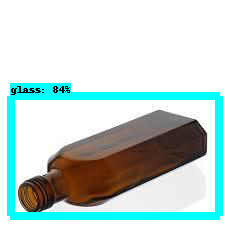

brown-glass10_jpg.rf.81c3869d44090dc00c2e62fced4be09f.jpg
True
brown-glass10_jpg.rf.81c3869d44090dc00c2e62fced4be09f.jpg
True


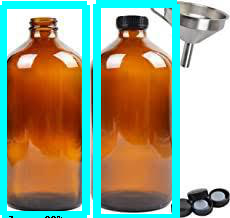

O_86_jpg.rf.893bb3c7392dc82526af2e9028bd38fb.jpg
True


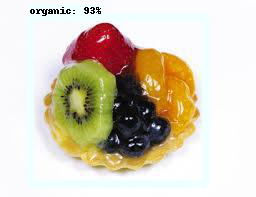

O_111_jpg.rf.cbdbbddb3a3d4b3bf9cca71487aced66.jpg
True
O_111_jpg.rf.cbdbbddb3a3d4b3bf9cca71487aced66.jpg
True
O_111_jpg.rf.cbdbbddb3a3d4b3bf9cca71487aced66.jpg
True
O_111_jpg.rf.cbdbbddb3a3d4b3bf9cca71487aced66.jpg
True


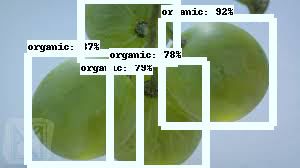

O_13598_jpg.rf.6d0867caf553468697536c80510bc483.jpg
True
O_13598_jpg.rf.6d0867caf553468697536c80510bc483.jpg
True
O_13598_jpg.rf.6d0867caf553468697536c80510bc483.jpg
True
O_13598_jpg.rf.6d0867caf553468697536c80510bc483.jpg
True
O_13598_jpg.rf.6d0867caf553468697536c80510bc483.jpg
True


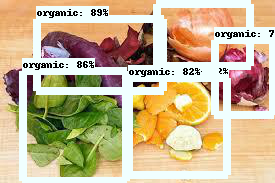

O_187_jpg.rf.56985ffab20d63e24511be14177eecab.jpg
True
O_187_jpg.rf.56985ffab20d63e24511be14177eecab.jpg
True
O_187_jpg.rf.56985ffab20d63e24511be14177eecab.jpg
True


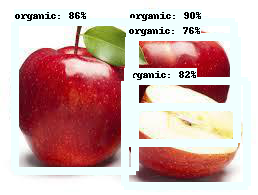

O_13109_jpg.rf.bbf89826ad86b6416df409435df9b8c5.jpg
True
O_13109_jpg.rf.bbf89826ad86b6416df409435df9b8c5.jpg
True
O_13109_jpg.rf.bbf89826ad86b6416df409435df9b8c5.jpg
True
O_13109_jpg.rf.bbf89826ad86b6416df409435df9b8c5.jpg
True
O_13109_jpg.rf.bbf89826ad86b6416df409435df9b8c5.jpg
True
O_13109_jpg.rf.bbf89826ad86b6416df409435df9b8c5.jpg
True
O_13109_jpg.rf.bbf89826ad86b6416df409435df9b8c5.jpg
True


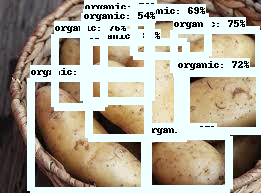

O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True
O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True
O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True
O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True
O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True
O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True
O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True
O_12876_jpg.rf.fa81ca228540ddb71fd46c1618df83e5.jpg
True


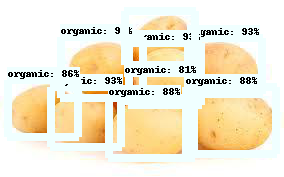

brown-glass60_jpg.rf.48ce7f45a0df6e8feaf4c18b0843f3b2.jpg
True
brown-glass60_jpg.rf.48ce7f45a0df6e8feaf4c18b0843f3b2.jpg
True
brown-glass60_jpg.rf.48ce7f45a0df6e8feaf4c18b0843f3b2.jpg
True


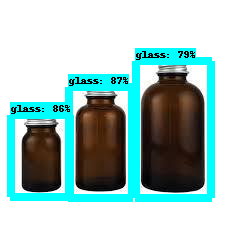

O_12639_jpg.rf.aaa03f6ee0f70fdeb958815ae020a8d3.jpg
True


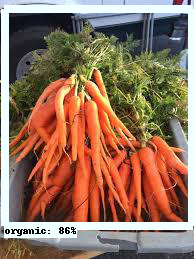

cardboard107_jpg.rf.cd3e5c8f5e20753f2d5789158a4441f3.jpg
True


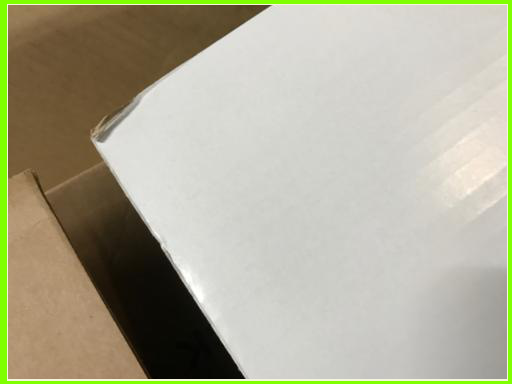

O_12838_jpg.rf.44bab81cbe182009ff6396272783ad1e.jpg
True


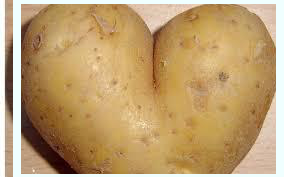

brown-glass25_jpg.rf.92ad9b093ed0e9cd6723b9d9da349267.jpg
True


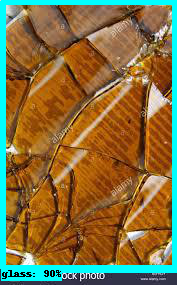

O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True
O_12841_jpg.rf.6a1e34b0adf9ea63275dd68169cba66f.jpg
True


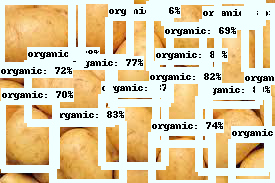

O_33_jpg.rf.74e1c3913718072baf3a456479dca28d.jpg
True


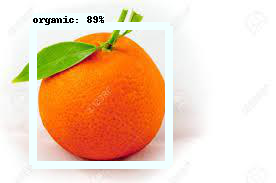

cardboard142_jpg.rf.e9eadac805e841609ddbba2ccb61136e.jpg
True


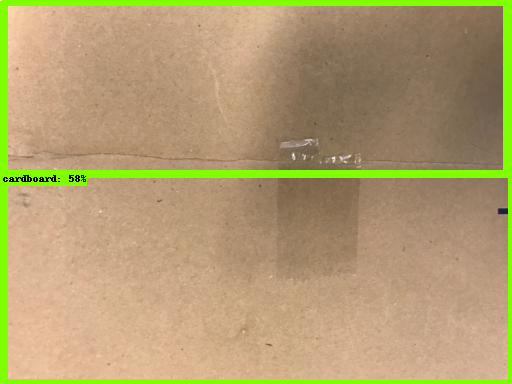

brown-glass27_jpg.rf.43cdff05904f5bf8b037c77c8510cc54.jpg
True


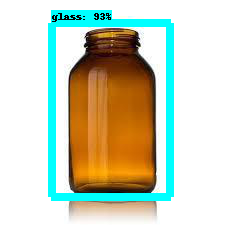

cardboard126_jpg.rf.0118cfc6e0b7739cdc5440260a8a923c.jpg
True


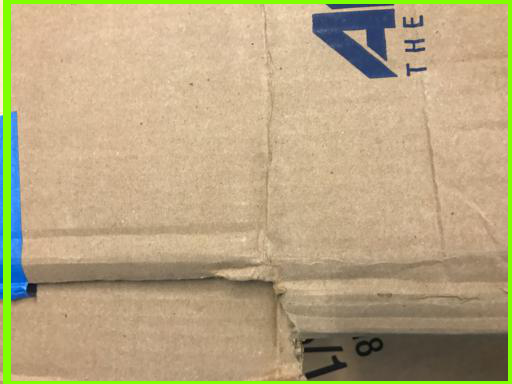

brown-glass16_jpg.rf.7c988c4459fd0df859d484444ee3b338.jpg
True


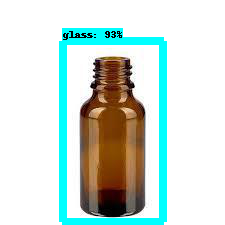

brown-glass19_jpg.rf.deaaf26a0648322a5940b461486ec3ea.jpg
True


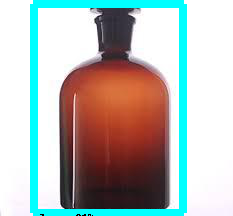

O_12618_jpg.rf.fd3561f13eb53f21bff94f2dc4252bf0.jpg
True


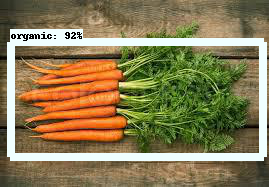

O_12875_jpg.rf.5cc6844cd5e80590a9275e159f841855.jpg
True
O_12875_jpg.rf.5cc6844cd5e80590a9275e159f841855.jpg
True


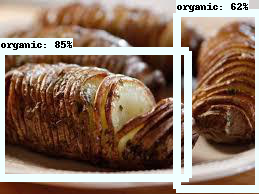

brown-glass63_jpg.rf.3ca21dee0b049d0dc4827607eee5fcc0.jpg
True
brown-glass63_jpg.rf.3ca21dee0b049d0dc4827607eee5fcc0.jpg
True
brown-glass63_jpg.rf.3ca21dee0b049d0dc4827607eee5fcc0.jpg
True
brown-glass63_jpg.rf.3ca21dee0b049d0dc4827607eee5fcc0.jpg
True
brown-glass63_jpg.rf.3ca21dee0b049d0dc4827607eee5fcc0.jpg
True


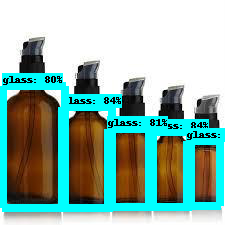

O_12594_jpg.rf.697fa087c06f183f7c56187730e1bc1e.jpg
True
O_12594_jpg.rf.697fa087c06f183f7c56187730e1bc1e.jpg
True
O_12594_jpg.rf.697fa087c06f183f7c56187730e1bc1e.jpg
True
O_12594_jpg.rf.697fa087c06f183f7c56187730e1bc1e.jpg
True
O_12594_jpg.rf.697fa087c06f183f7c56187730e1bc1e.jpg
True
O_12594_jpg.rf.697fa087c06f183f7c56187730e1bc1e.jpg
True


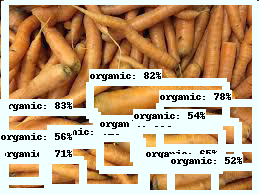

cardboard164_jpg.rf.bca0d59df4db432826647d70a73ac175.jpg
True


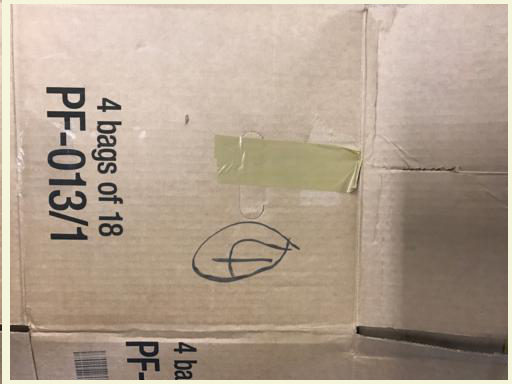

O_31_jpg.rf.24fe26b5d04841be09f593eceb2d45a0.jpg
True


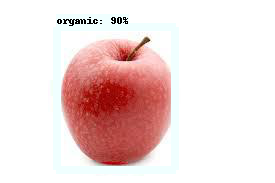

O_24_jpg.rf.f782de8df103ef2e9536e6869695e7ff.jpg
True
O_24_jpg.rf.f782de8df103ef2e9536e6869695e7ff.jpg
True
O_24_jpg.rf.f782de8df103ef2e9536e6869695e7ff.jpg
True


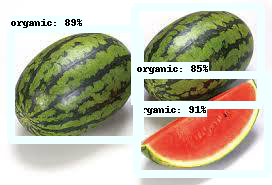

O_12598_jpg.rf.7ca50f7e6d8ad558971dfa08225d7993.jpg
True


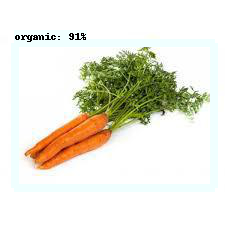

O_124_jpg.rf.49ff0997466077153ada99d134bb4b99.jpg
True


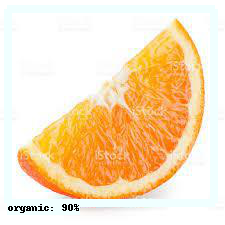

O_151_jpg.rf.41f5f9cfa2c04431e905994a527b6aa1.jpg
True
O_151_jpg.rf.41f5f9cfa2c04431e905994a527b6aa1.jpg
True
O_151_jpg.rf.41f5f9cfa2c04431e905994a527b6aa1.jpg
True
O_151_jpg.rf.41f5f9cfa2c04431e905994a527b6aa1.jpg
True
O_151_jpg.rf.41f5f9cfa2c04431e905994a527b6aa1.jpg
True
O_151_jpg.rf.41f5f9cfa2c04431e905994a527b6aa1.jpg
True
O_151_jpg.rf.41f5f9cfa2c04431e905994a527b6aa1.jpg
True


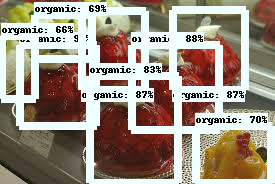

O_2_jpg.rf.2be156b211a1646ef8f9e5c6b3a4739f.jpg
True


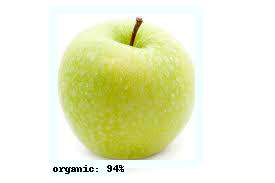

brown-glass65_jpg.rf.142ab146394cf74ff56de5402d356458.jpg
True


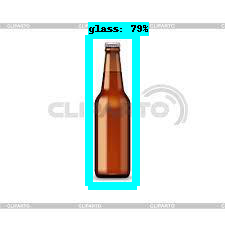

O_73_jpg.rf.b2a8b3134d3373e1aa510e108a82111d.jpg
True
O_73_jpg.rf.b2a8b3134d3373e1aa510e108a82111d.jpg
True


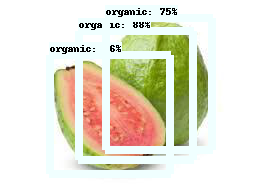

O_12886_jpg.rf.a42208f343a5ea443c74a80e15e4e062.jpg
True


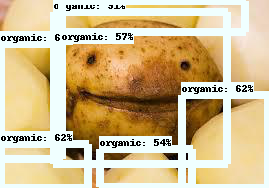

O_7_jpg.rf.f167c05be219598b233e9b90b00555f5.jpg
True
O_7_jpg.rf.f167c05be219598b233e9b90b00555f5.jpg
True


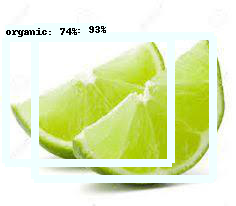

O_96_jpg.rf.1052b17b2c59741a63890ab297a3cd5b.jpg
True


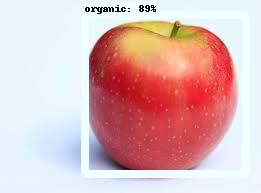

O_12666_jpg.rf.48e1ebd772aa4fe54924a70344a32148.jpg
True
O_12666_jpg.rf.48e1ebd772aa4fe54924a70344a32148.jpg
True
O_12666_jpg.rf.48e1ebd772aa4fe54924a70344a32148.jpg
True
O_12666_jpg.rf.48e1ebd772aa4fe54924a70344a32148.jpg
True


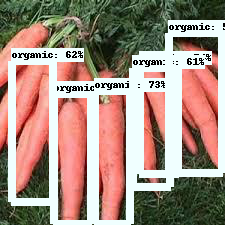

O_54_jpg.rf.20968b7135e2be1c511c44b76d16fc36.jpg
True


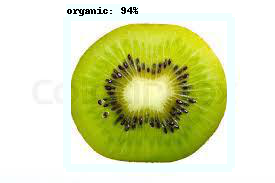

brown-glass46_jpg.rf.54c5f54caaca0a36e72e977abfbe5d28.jpg
True
brown-glass46_jpg.rf.54c5f54caaca0a36e72e977abfbe5d28.jpg
True
brown-glass46_jpg.rf.54c5f54caaca0a36e72e977abfbe5d28.jpg
True
brown-glass46_jpg.rf.54c5f54caaca0a36e72e977abfbe5d28.jpg
True


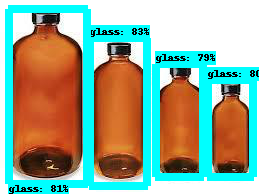

brown-glass32_jpg.rf.5ba0638170b5e342e4c5371bdb6fe642.jpg
True


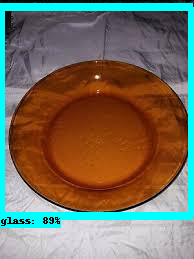

O_140_jpg.rf.cdeaa49ae0d96df5daba050a43078874.jpg
True


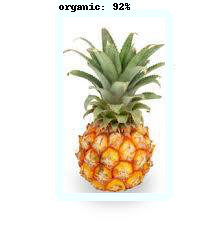

O_13604_jpg.rf.a5e70f8e32c559bfcb76ccd9b1d4a237.jpg
True


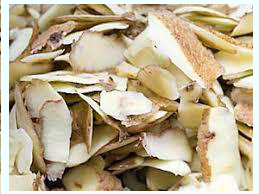

brown-glass24_jpg.rf.876a050bfa8155bb18f856f9f3f999f0.jpg
True
brown-glass24_jpg.rf.876a050bfa8155bb18f856f9f3f999f0.jpg
True
brown-glass24_jpg.rf.876a050bfa8155bb18f856f9f3f999f0.jpg
True
brown-glass24_jpg.rf.876a050bfa8155bb18f856f9f3f999f0.jpg
True
brown-glass24_jpg.rf.876a050bfa8155bb18f856f9f3f999f0.jpg
True


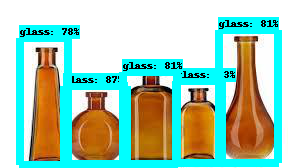

brown-glass212_jpg.rf.b936dd21913db58a336e921e58ffb627.jpg
True
brown-glass212_jpg.rf.b936dd21913db58a336e921e58ffb627.jpg
True
brown-glass212_jpg.rf.b936dd21913db58a336e921e58ffb627.jpg
True
brown-glass212_jpg.rf.b936dd21913db58a336e921e58ffb627.jpg
True
brown-glass212_jpg.rf.b936dd21913db58a336e921e58ffb627.jpg
True
brown-glass212_jpg.rf.b936dd21913db58a336e921e58ffb627.jpg
True


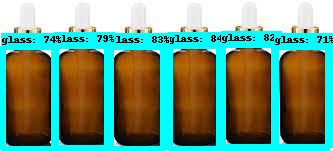

O_12636_jpg.rf.fd92e76df4c9d46676d131de9ef7cfef.jpg
True
O_12636_jpg.rf.fd92e76df4c9d46676d131de9ef7cfef.jpg
True
O_12636_jpg.rf.fd92e76df4c9d46676d131de9ef7cfef.jpg
True
O_12636_jpg.rf.fd92e76df4c9d46676d131de9ef7cfef.jpg
True
O_12636_jpg.rf.fd92e76df4c9d46676d131de9ef7cfef.jpg
True


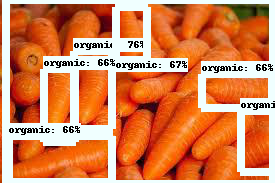

cardboard150_jpg.rf.620af31a3197ae0af4830868617b5a43.jpg
True


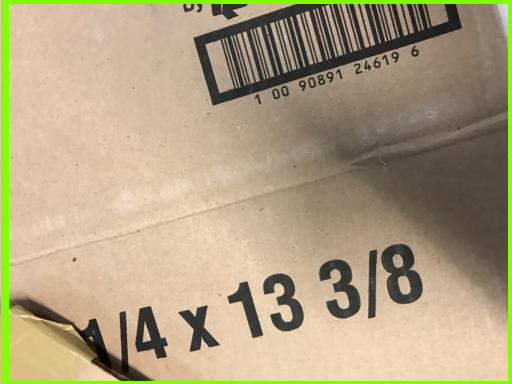

O_12877_jpg.rf.22ebe0208264f6bd70a977b4a7eaf4fd.jpg
True
O_12877_jpg.rf.22ebe0208264f6bd70a977b4a7eaf4fd.jpg
True
O_12877_jpg.rf.22ebe0208264f6bd70a977b4a7eaf4fd.jpg
True
O_12877_jpg.rf.22ebe0208264f6bd70a977b4a7eaf4fd.jpg
True
O_12877_jpg.rf.22ebe0208264f6bd70a977b4a7eaf4fd.jpg
True


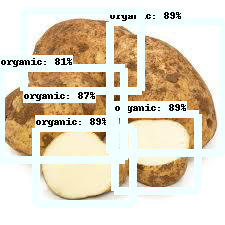

O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True
O_169_jpg.rf.3e48e7833664c9a113321365f51d996e.jpg
True


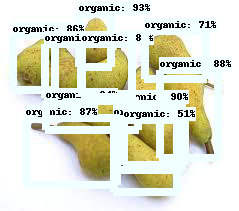

cardboard157_jpg.rf.3ada7ec32894534245369afbb69225b7.jpg
True


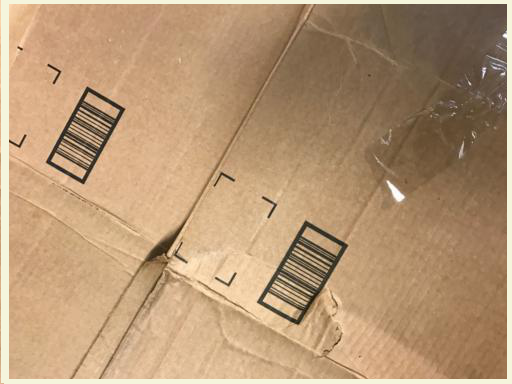

brown-glass21_jpg.rf.3528c54fdf1ce1f6ec93af72ed6f9e29.jpg
True
brown-glass21_jpg.rf.3528c54fdf1ce1f6ec93af72ed6f9e29.jpg
True
brown-glass21_jpg.rf.3528c54fdf1ce1f6ec93af72ed6f9e29.jpg
True
brown-glass21_jpg.rf.3528c54fdf1ce1f6ec93af72ed6f9e29.jpg
True


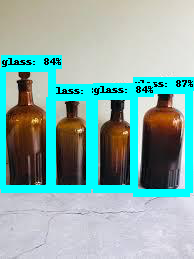

O_12652_jpg.rf.bee1c7c48f238e11861ddbfa6a878b68.jpg
True


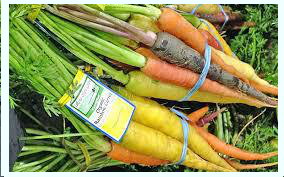

O_12619_jpg.rf.60b5b4822cad372d9a87c42977a11cb2.jpg
True
O_12619_jpg.rf.60b5b4822cad372d9a87c42977a11cb2.jpg
True
O_12619_jpg.rf.60b5b4822cad372d9a87c42977a11cb2.jpg
True
O_12619_jpg.rf.60b5b4822cad372d9a87c42977a11cb2.jpg
True
O_12619_jpg.rf.60b5b4822cad372d9a87c42977a11cb2.jpg
True


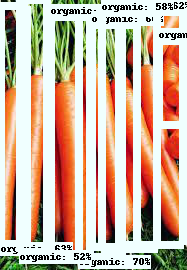

O_12893_jpg.rf.e7f64e0ed6b742a52df617f93ef856b3.jpg
True


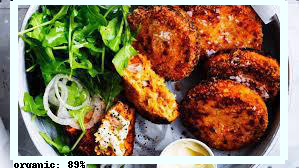

brown-glass6_jpg.rf.821467fb9e6b2d6dac7a5b63295502e8.jpg
True
brown-glass6_jpg.rf.821467fb9e6b2d6dac7a5b63295502e8.jpg
True
brown-glass6_jpg.rf.821467fb9e6b2d6dac7a5b63295502e8.jpg
True
brown-glass6_jpg.rf.821467fb9e6b2d6dac7a5b63295502e8.jpg
True
brown-glass6_jpg.rf.821467fb9e6b2d6dac7a5b63295502e8.jpg
True
brown-glass6_jpg.rf.821467fb9e6b2d6dac7a5b63295502e8.jpg
True
brown-glass6_jpg.rf.821467fb9e6b2d6dac7a5b63295502e8.jpg
True


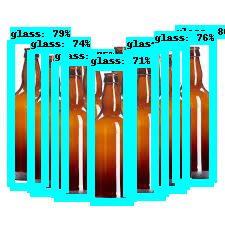

cardboard161_jpg.rf.494fe6104119113c5f4e4152d22df9f4.jpg
True


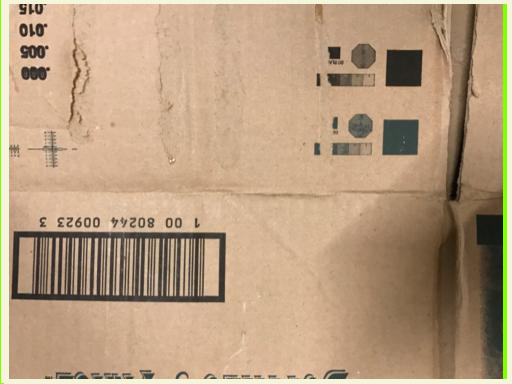

brown-glass64_jpg.rf.9e8662038799baf1a672a126ceb9cce9.jpg
True


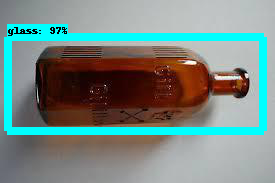

O_12663_jpg.rf.32df6714c4322265be35f9e1b43a8f56.jpg
True
O_12663_jpg.rf.32df6714c4322265be35f9e1b43a8f56.jpg
True
O_12663_jpg.rf.32df6714c4322265be35f9e1b43a8f56.jpg
True


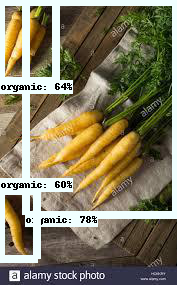

cardboard105_jpg.rf.7a0dbd2b412e6bb388feffd1350489e0.jpg
True


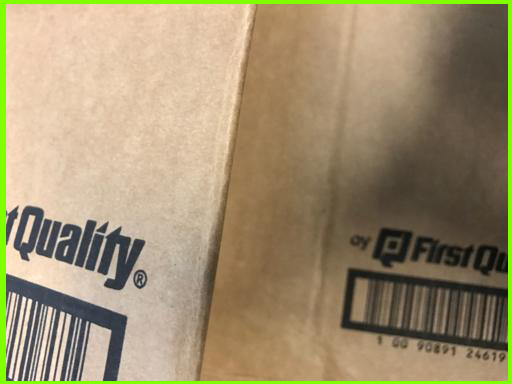

O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True
O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True
O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True
O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True
O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True
O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True
O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True
O_12630_jpg.rf.7344a133a5e6adb44e11b0739bc4f225.jpg
True


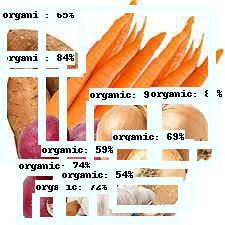

brown-glass202_jpg.rf.823437c33abe92351b1a73c110d49fb3.jpg
True


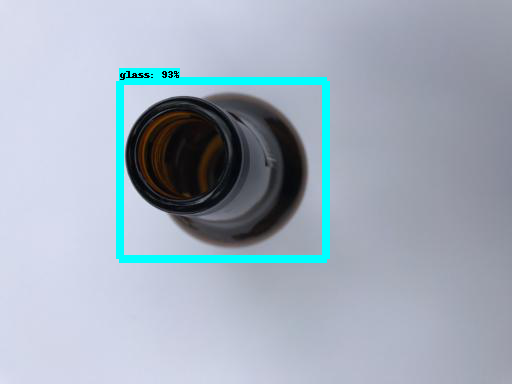

O_181_jpg.rf.aa873b376c4ea0b3d49141ac701e14f6.jpg
True
O_181_jpg.rf.aa873b376c4ea0b3d49141ac701e14f6.jpg
True


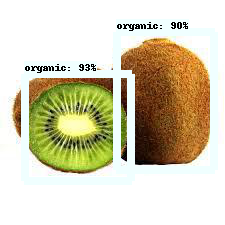

O_168_jpg.rf.5eb85ac339a0e6350628523d9b076ecd.jpg
True
O_168_jpg.rf.5eb85ac339a0e6350628523d9b076ecd.jpg
True
O_168_jpg.rf.5eb85ac339a0e6350628523d9b076ecd.jpg
True


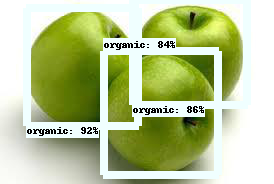

O_175_jpg.rf.bd0e075e26fe84fced87bd90764ecbd0.jpg
True


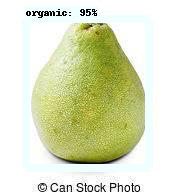

cardboard12_jpg.rf.282de94a1be6163ea2e41cd68fa0c70b.jpg
True


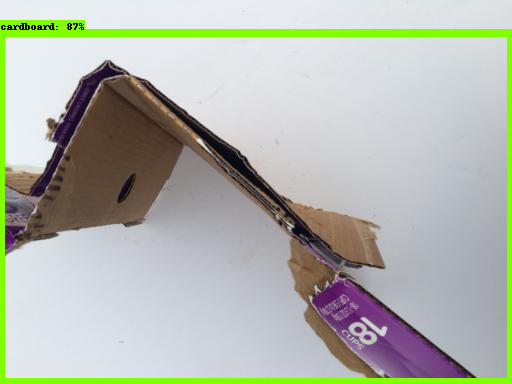

O_12682_jpg.rf.c00deeededc3eb9308305657aac1b8fa.jpg
True
O_12682_jpg.rf.c00deeededc3eb9308305657aac1b8fa.jpg
True


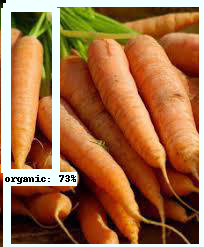

O_13108_jpg.rf.4b77a08c12a450eaf4f74a8d2726ec9b.jpg
True


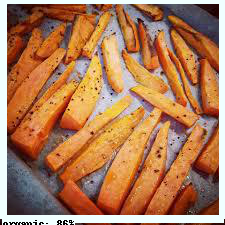

paper1036_jpg.rf.788fd3cb8dd94027c154319552f464ae.jpg
True


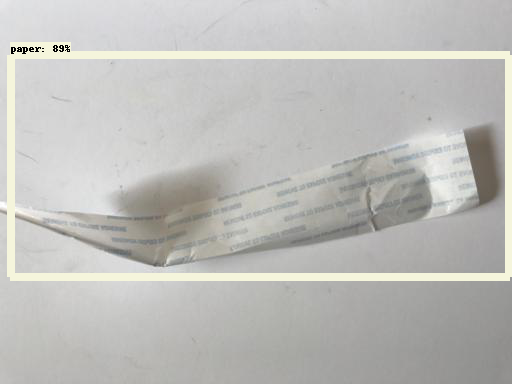

cardboard91_jpg.rf.33b3aade63f05f87ef1372025bc7470b.jpg
True


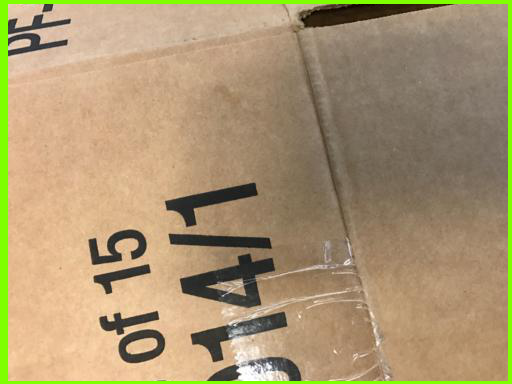

cardboard25_jpg.rf.50efbbd98b9f3f7064419cd054f5cab6.jpg
True


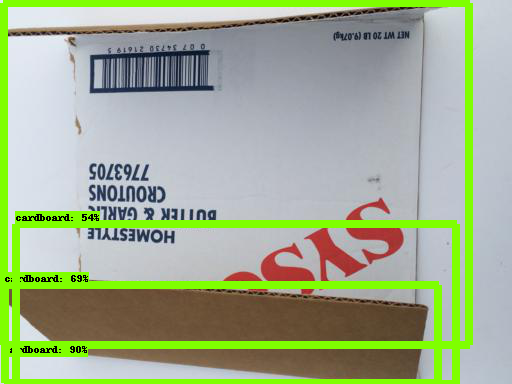

metal4_jpg.rf.7456f8e0a39911dfcd47cfd982571299.jpg
True


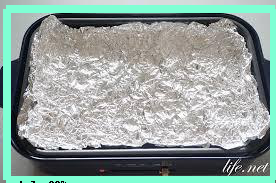

green-glass55_jpg.rf.b804d47b90bfd42c02982582c55b7367.jpg
True


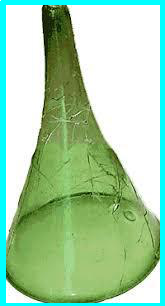

green-glass25_jpg.rf.5570a2f5c7d7946437a5326063127db2.jpg
True
green-glass25_jpg.rf.5570a2f5c7d7946437a5326063127db2.jpg
True
green-glass25_jpg.rf.5570a2f5c7d7946437a5326063127db2.jpg
True
green-glass25_jpg.rf.5570a2f5c7d7946437a5326063127db2.jpg
True


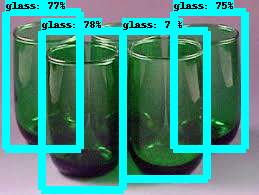

metal83_jpg.rf.262ad7e8f6ca440833541860e56e95ae.jpg
True


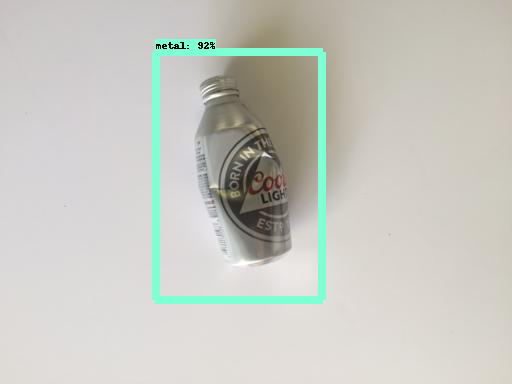

cardboard234_jpg.rf.e9664cc1968f49f44c47c603882e5af3.jpg
True


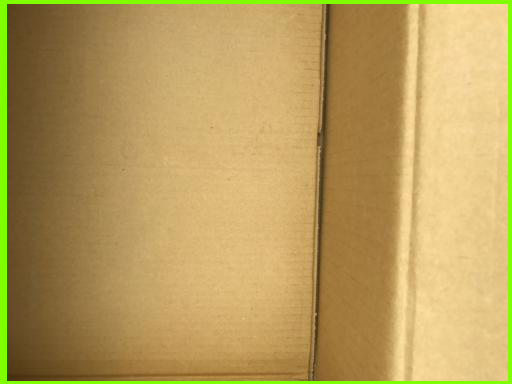

metal51_jpg.rf.465d7d2e124947fcee8f97aaccf505c4.jpg
True


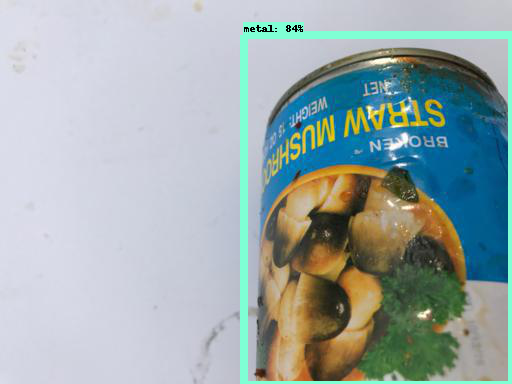

paper1016_jpg.rf.07e652d0c5cb6379cff9ef719f2e5180.jpg
True


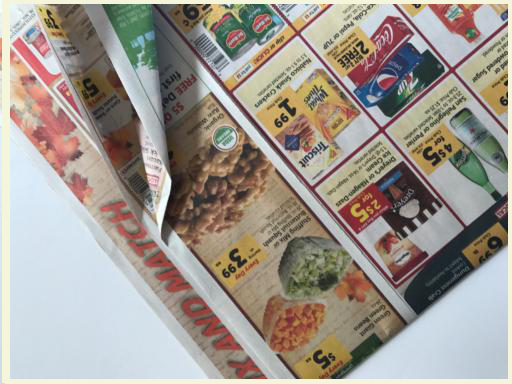

metal43_jpg.rf.447da9af4883ec9d858d723702cce023.jpg
True


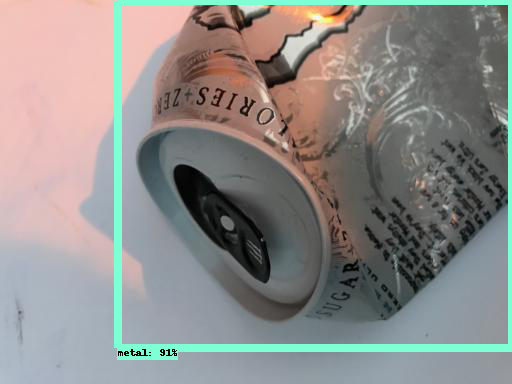

green-glass14_jpg.rf.dd52283fd9bbcc68565a18f6271409a5.jpg
True


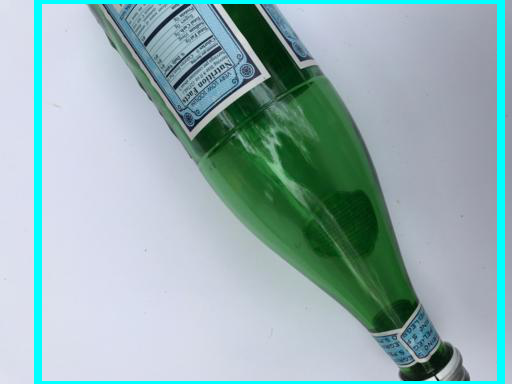

paper1033_jpg.rf.e744de8dec2cad7730794d746b5c94d3.jpg
True


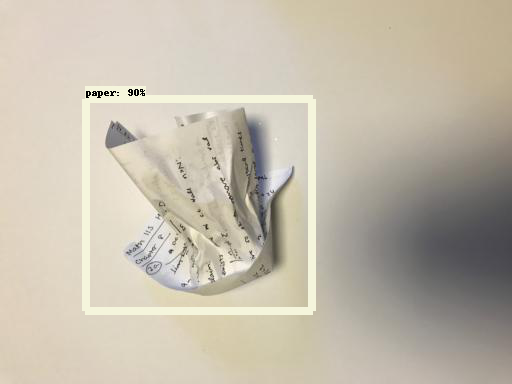

paper1049_jpg.rf.159fe9dbae27111b154a8eaa85259309.jpg
True


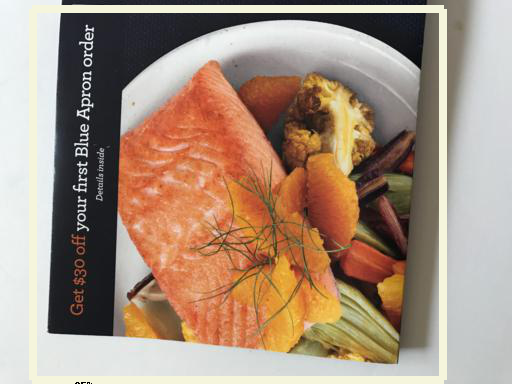

cardboard190_jpg.rf.dd071c246f4849da6a21f2f6d0a6a5cc.jpg
True


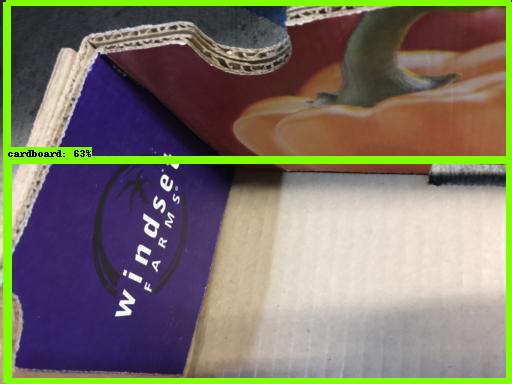

green-glass44_jpg.rf.920e06822b0e9faf8f86e122a220e866.jpg
True


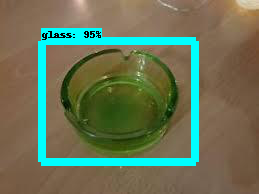

metal25_jpg.rf.f42bc58599aa5b607aba1e213750c549.jpg
True


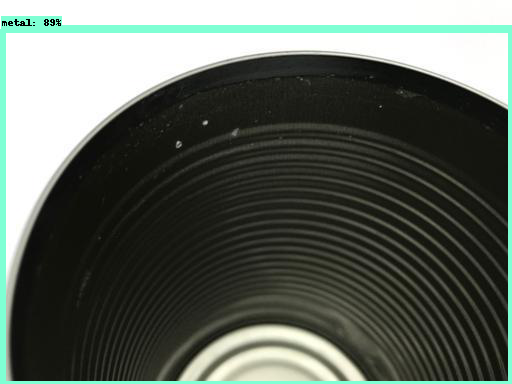

metal221_jpg.rf.f8cb05bbde2683082c10cc0b88df40d9.jpg
True


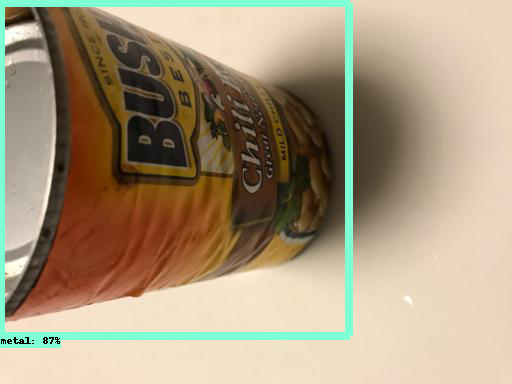

metal109_jpg.rf.80d0c4aa0e8919982990e593b97cd7f2.jpg
True


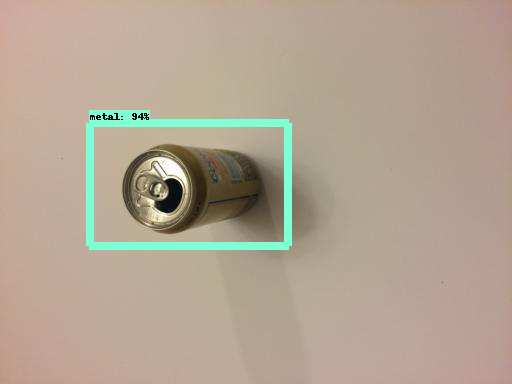

cardboard192_jpg.rf.acf4b081c7e121b12bc6e34a1a6aea43.jpg
True


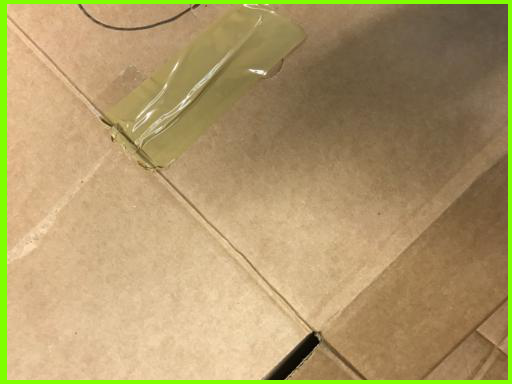

metal182_jpg.rf.e06191ede24f22534ee375ba4bb727fc.jpg
True


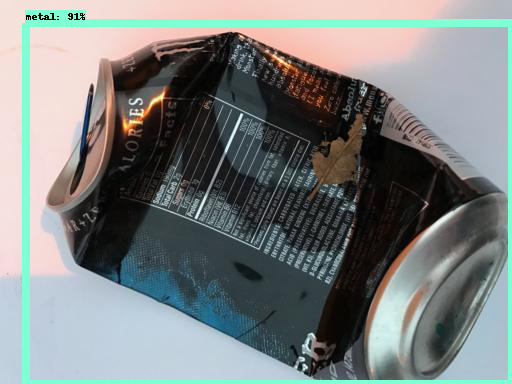

metal17_jpg.rf.834194c948b640638e9aac6e7b86e293.jpg
True


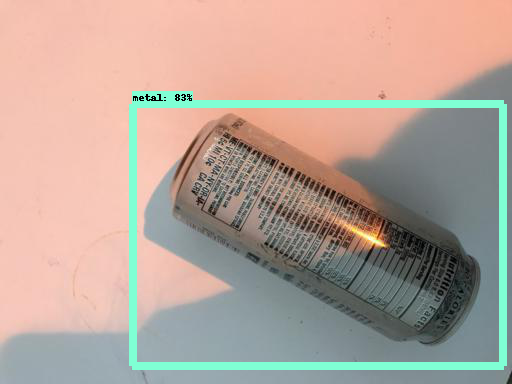

green-glass52_jpg.rf.f133a313987916d808b3b7378146bddd.jpg
True


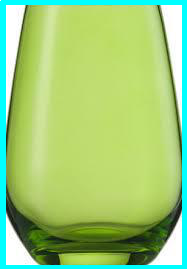

green-glass201_jpg.rf.5f449f987d03793bc1b30490131509cf.jpg
True
green-glass201_jpg.rf.5f449f987d03793bc1b30490131509cf.jpg
True


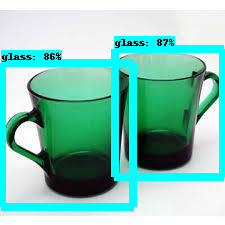

metal177_jpg.rf.290f8baa16b9e76f069f619e7acfac62.jpg
True


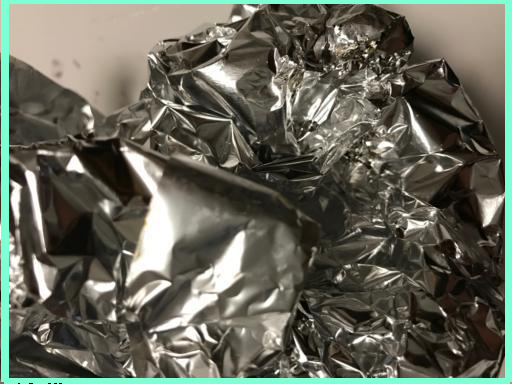

paper1011_jpg.rf.973c17105108496cfd45902b398852f1.jpg
True


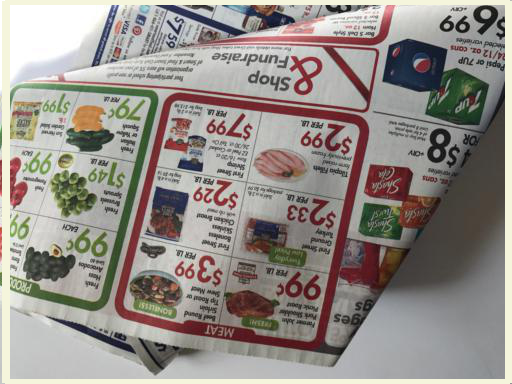

cardboard232_jpg.rf.e2e70e0f0e6cb513293c52c15cd4988c.jpg
True


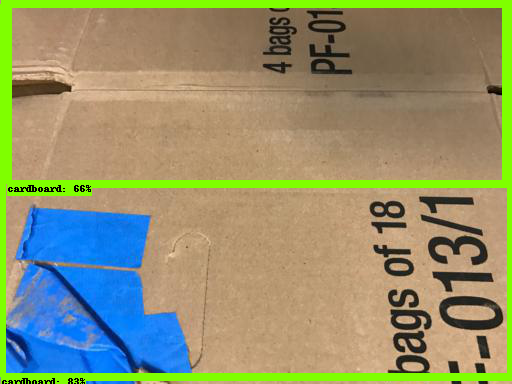

cardboard191_jpg.rf.881dde02dfa59389a2a28a78396b2e6a.jpg
True


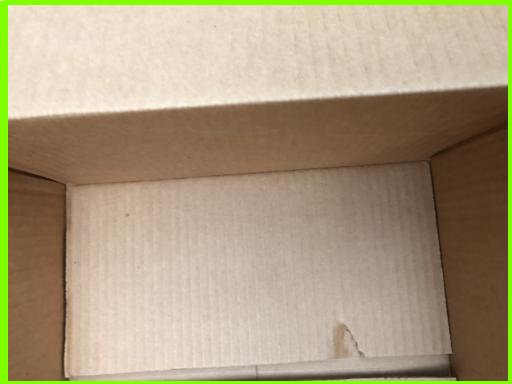

paper1046_jpg.rf.938b6dda7d1e15594834a1e6e5cbd091.jpg
True


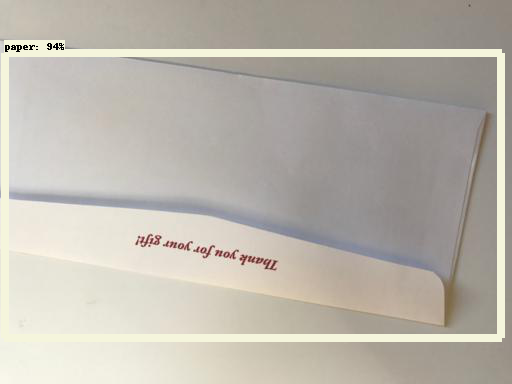

cardboard62_jpg.rf.efe3c9b2afc9dd3245157354ed5b7a84.jpg
True


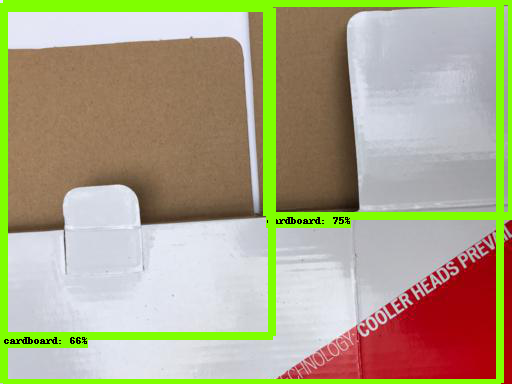

metal68_jpg.rf.a60430f44a327b5c1461d42f49eb8b90.jpg
True


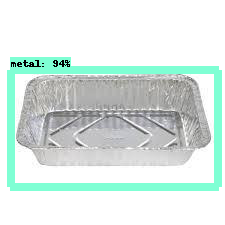

metal217_jpg.rf.e5698e91edd8ce425b69bed132ba8327.jpg
True


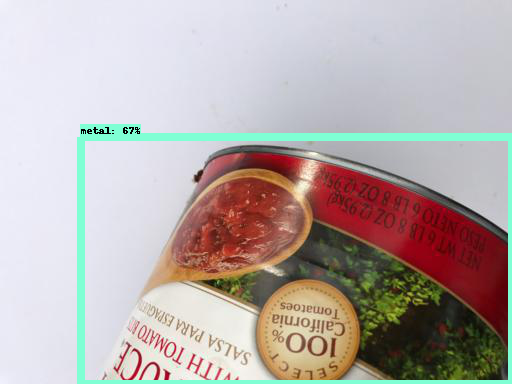

metal115_jpg.rf.12b11853a18bd233ee03e1cc37af33fc.jpg
True


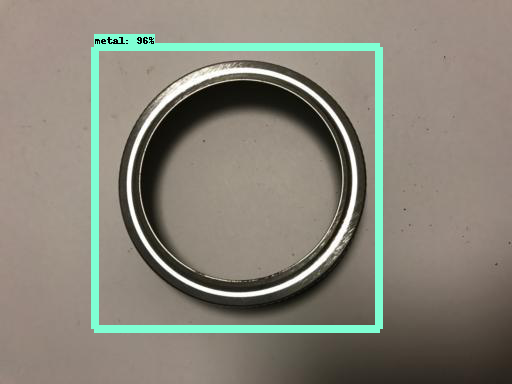

cardboard212_jpg.rf.bb442f7b44be7ff5f9461539ab7f9f7d.jpg
True


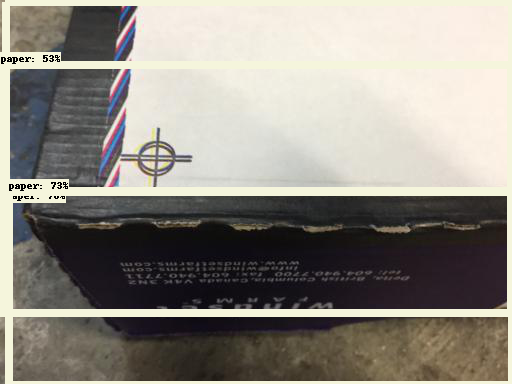

cardboard216_jpg.rf.afa051a3a7e4c18363cb0e6e78a476ea.jpg
True


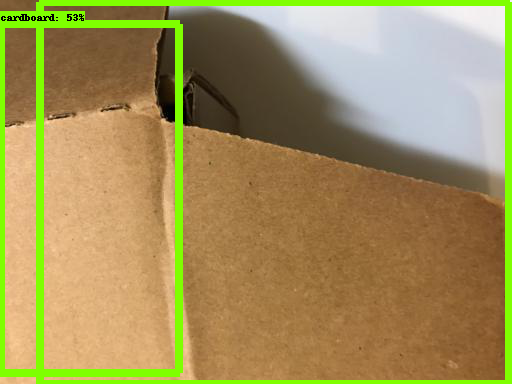

metal35_jpg.rf.1d4b97b7f30169efa3ee3f9231ed6fdb.jpg
True


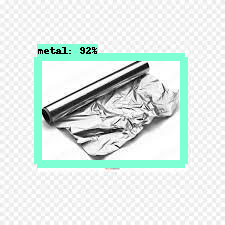

metal72_jpg.rf.ebd76a23358dc575a80a72aa96cf398a.jpg
True


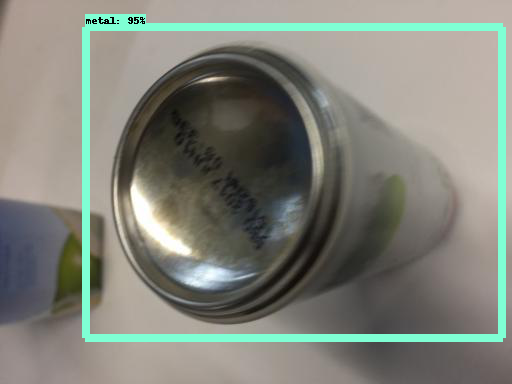

paper1048_jpg.rf.41cb561450f7105c8a6f0127574caacc.jpg
True


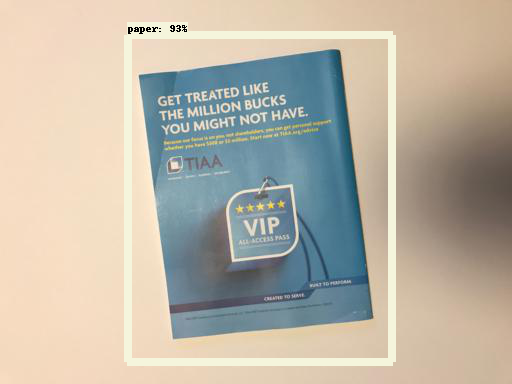

cardboard74_jpg.rf.65336ba27c9989c4489802a11c3a6e54.jpg
True


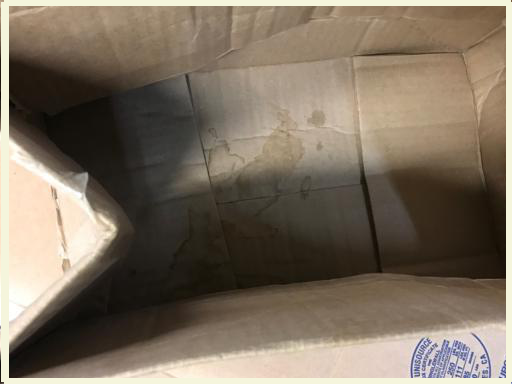

metal7_jpg.rf.1462346644b0a315f1a49c0b42de0b15.jpg
True


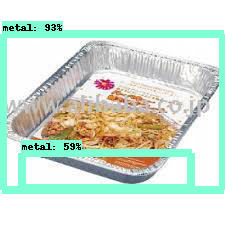

metal105_jpg.rf.c98ecf56b30de93849a633fa93028ef6.jpg
True


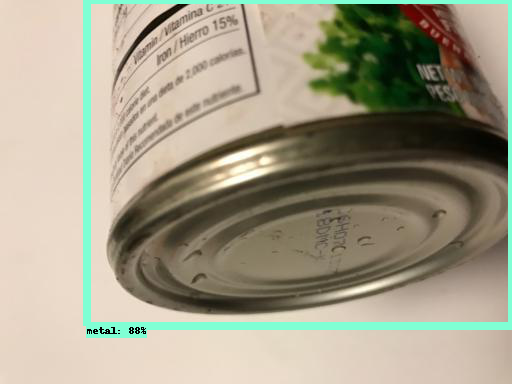

metal107_jpg.rf.6fc9aac1013ad0c529f0d84372faaec3.jpg
True


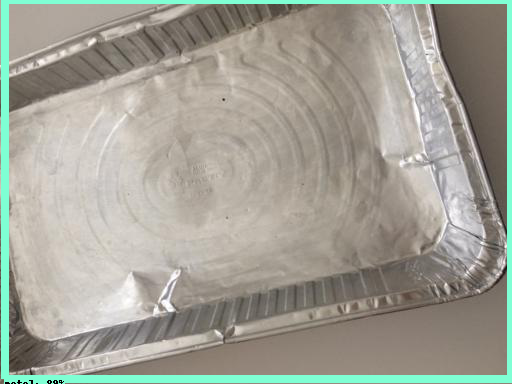

metal86_jpg.rf.ad47735367c5f801e520c69badd05a3c.jpg
True


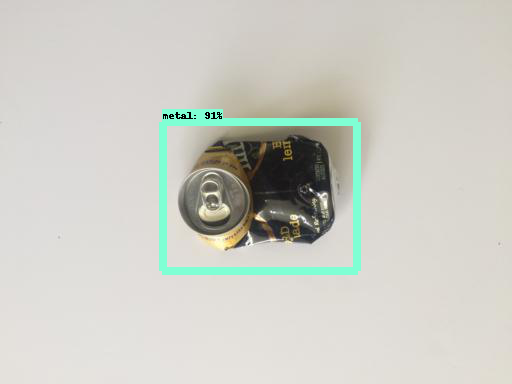

metal142_jpg.rf.f1e0ca5e555100fa7d530cd67259a7de.jpg
True


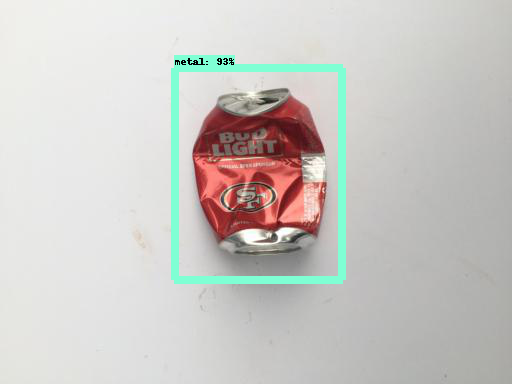

metal133_jpg.rf.b2a2e32357064c71c79edfe5eee58e5e.jpg
True


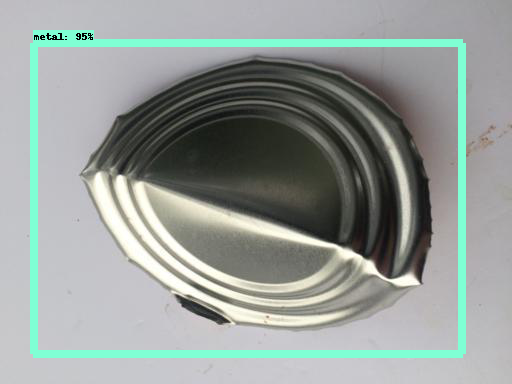

metal219_jpg.rf.6cc227096cb45a3726fcffd3ea652b58.jpg
True


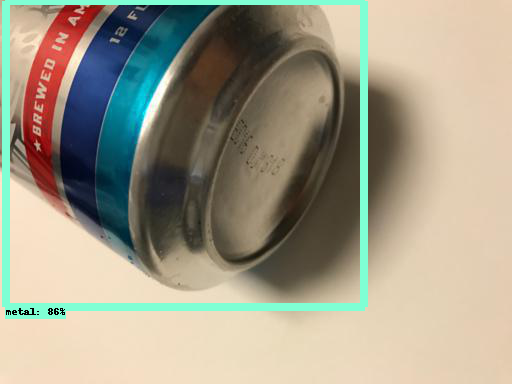

paper1019_jpg.rf.ce02b411cc001c12b6ca8823b81f1158.jpg
True


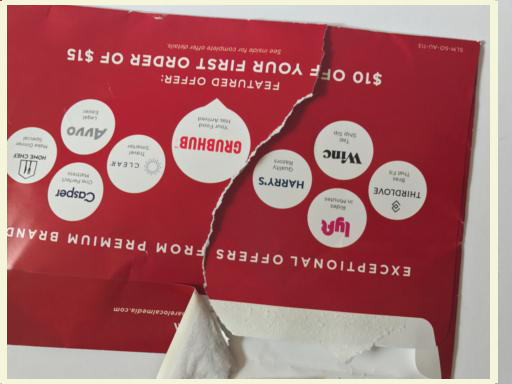

green-glass50_jpg.rf.88ce46757a4d7762859be9d0e19be0ec.jpg
True


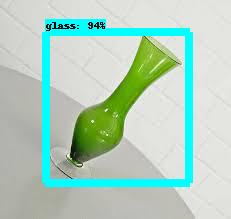

metal143_jpg.rf.8e0f4b7518e01a604d0e3abecef5abaf.jpg
True


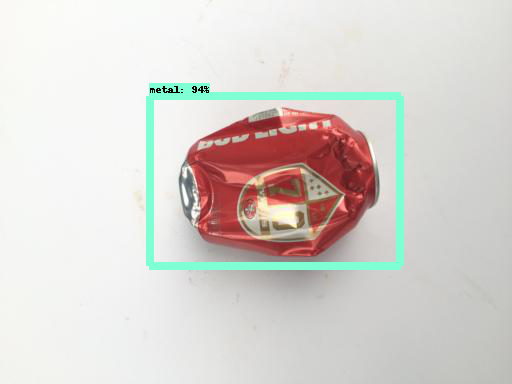

paper1001_jpg.rf.76623a03ec43d747025d846e264c29ec.jpg
True


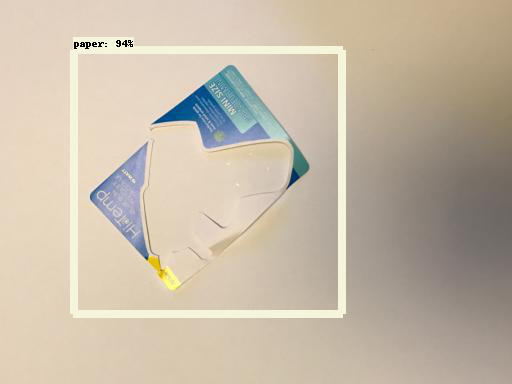

paper1025_jpg.rf.5615ac2a652d33891f29dbe15d258d93.jpg
True


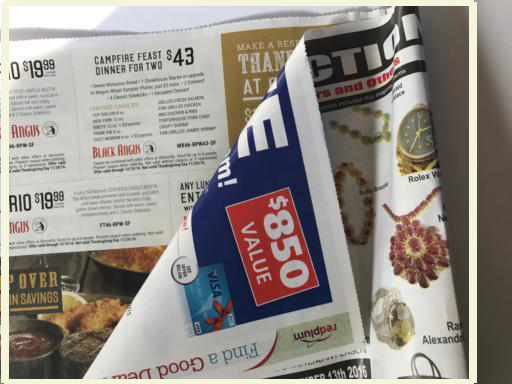

cardboard8_jpg.rf.ca43489a5db5fd4d9c1ddb0cc2b50187.jpg
True


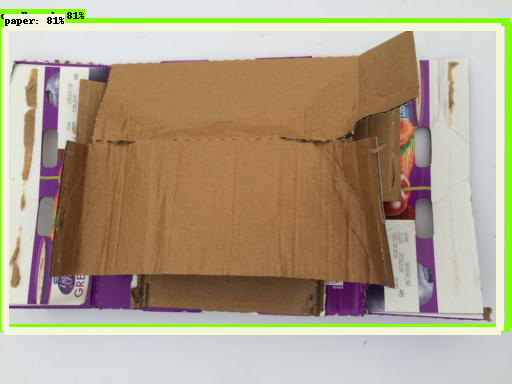

green-glass54_jpg.rf.4b210a71b72419634fe13ee13e751dad.jpg
True


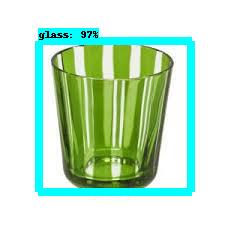

metal65_jpg.rf.6fcec21341e99544fa1739f6bc639281.jpg
True


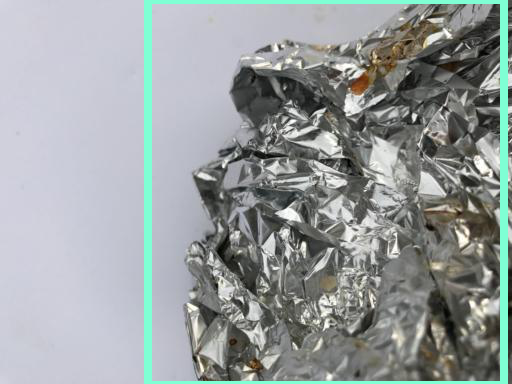

paper1003_jpg.rf.d702bb2c11d98d6627da22293fa33cee.jpg
True


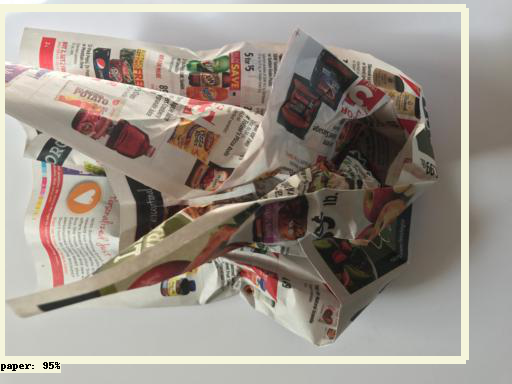

metal160_jpg.rf.79f8ba236efd0e7346e63797dbbe6151.jpg
True


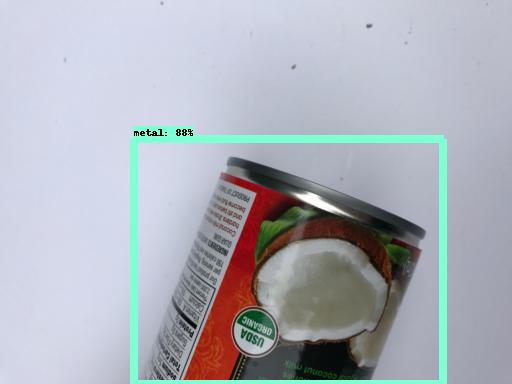

cardboard65_jpg.rf.91f5d6a231906416f2275cb3f7a8deec.jpg
True


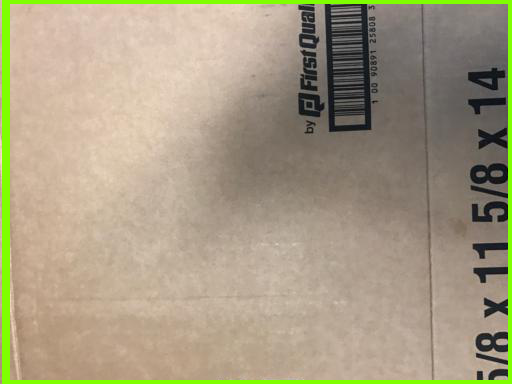

metal52_jpg.rf.f72bd535727e148b3743e5774011d17b.jpg
True


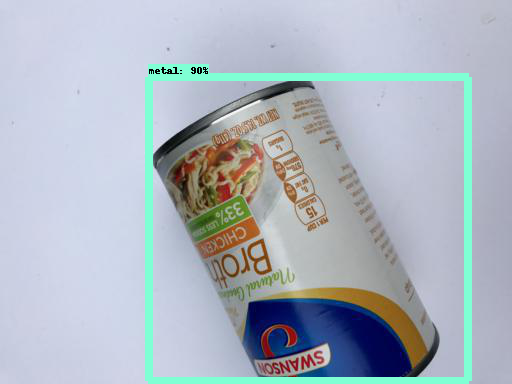

metal220_jpg.rf.8f23b9026ea4f4846354e8dd9cbddcb3.jpg
True


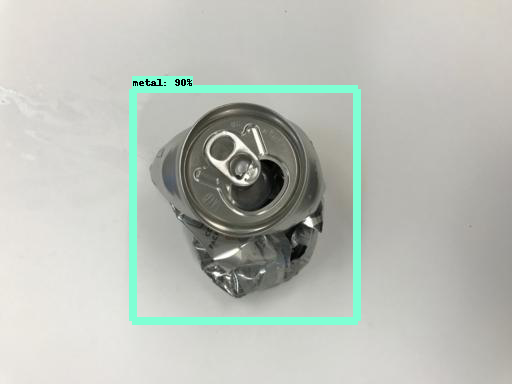

metal210_jpg.rf.4466cf218a34327ec3560e41d49887aa.jpg
True


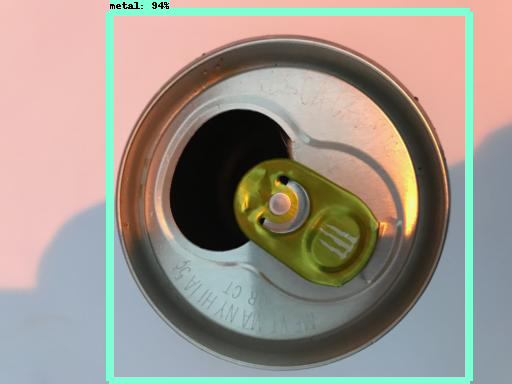

green-glass38_jpg.rf.74213aa8d958bed361cf6848e30470b5.jpg
True
green-glass38_jpg.rf.74213aa8d958bed361cf6848e30470b5.jpg
True
green-glass38_jpg.rf.74213aa8d958bed361cf6848e30470b5.jpg
True


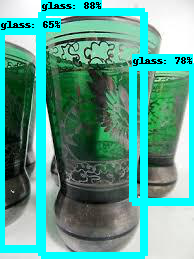

metal75_jpg.rf.7a75dd469bdd1ea6a28d188c784c61ba.jpg
True


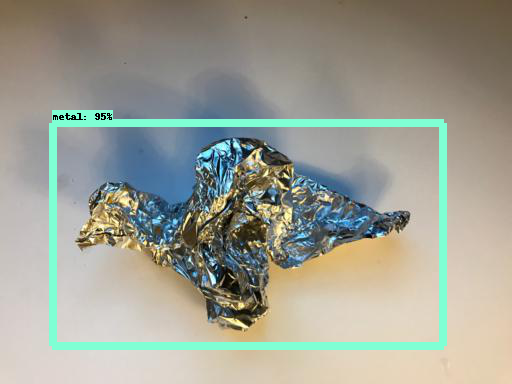

metal82_jpg.rf.2c65f15ed46d5dc1450230c22260421b.jpg
True


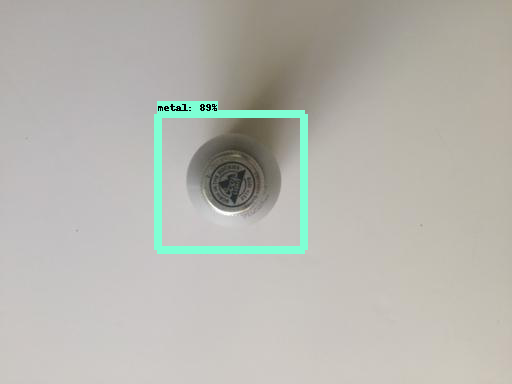

metal40_jpg.rf.6d8a29283860823b813cd2d298b827ab.jpg
True


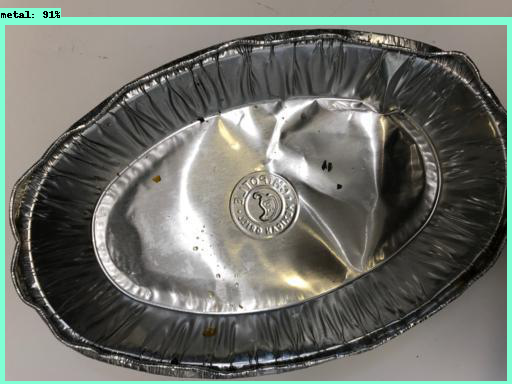

green-glass57_jpg.rf.bc17a942ca69d019204730851d96d212.jpg
True


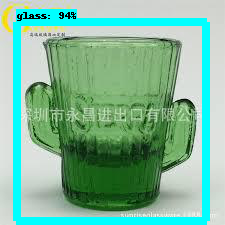

green-glass2_jpg.rf.9392f1b0fd49dc4f5aa8db1f9b24274a.jpg
True
green-glass2_jpg.rf.9392f1b0fd49dc4f5aa8db1f9b24274a.jpg
True
green-glass2_jpg.rf.9392f1b0fd49dc4f5aa8db1f9b24274a.jpg
True
green-glass2_jpg.rf.9392f1b0fd49dc4f5aa8db1f9b24274a.jpg
True
green-glass2_jpg.rf.9392f1b0fd49dc4f5aa8db1f9b24274a.jpg
True
green-glass2_jpg.rf.9392f1b0fd49dc4f5aa8db1f9b24274a.jpg
True


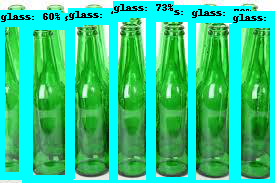

metal237_jpg.rf.afe25c5ed3bf30e7a6f47c5aa883e418.jpg
True


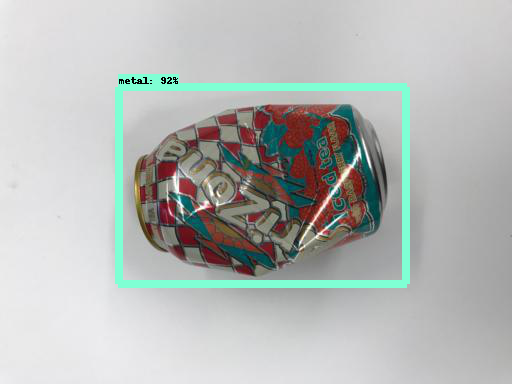

cardboard242_jpg.rf.6324451b7cddacfb4c9e43721a51b524.jpg
True


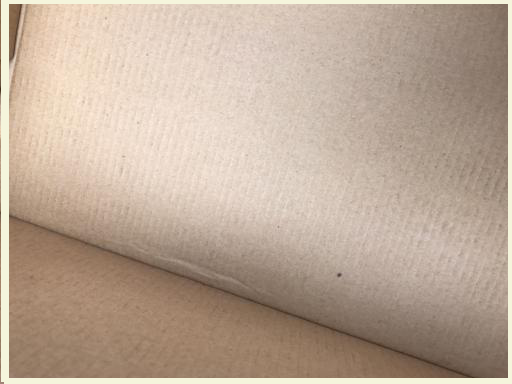

metal184_jpg.rf.3c8387e3accbb3353752fd1a942c3adb.jpg
True


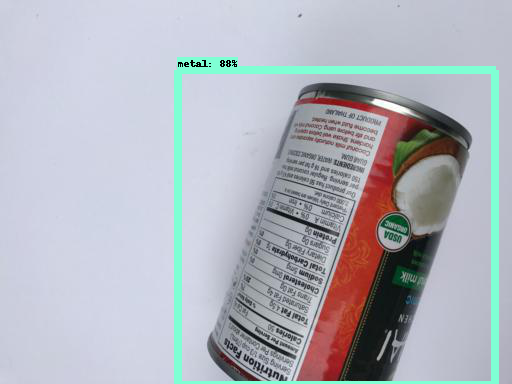

paper1032_jpg.rf.10bb872501e22f198c777e4081369158.jpg
True


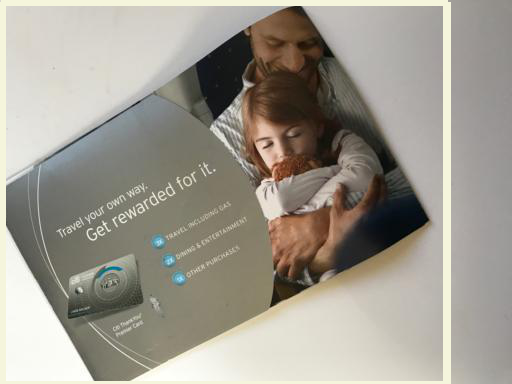

green-glass65_jpg.rf.ac53fae16d97f59b93eda42717cd55d6.jpg
True


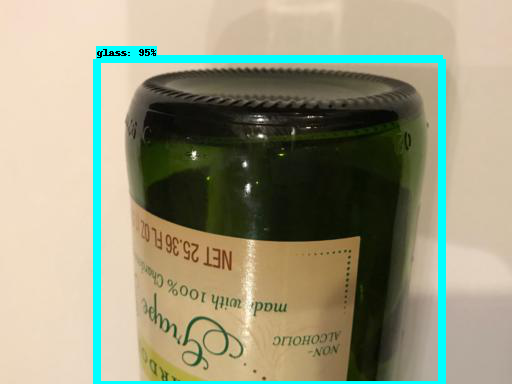

metal19_jpg.rf.a60ab83fd743fd3217f7bf6c7b25f65a.jpg
True


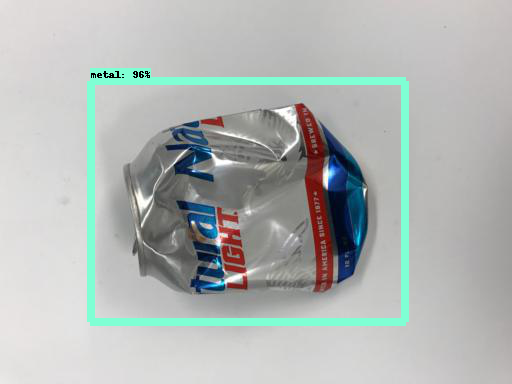

metal129_jpg.rf.ff4521ee33569431039201fd80652a13.jpg
True


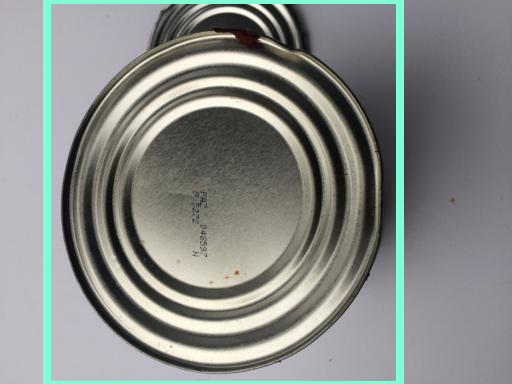

paper1010_jpg.rf.471ffe85f91ffb2102efb0226ad258d8.jpg
True


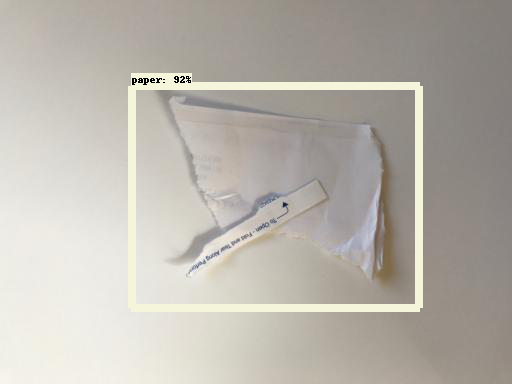

cardboard82_jpg.rf.0b57d20a18877e80f7b2b534d81c074e.jpg
True


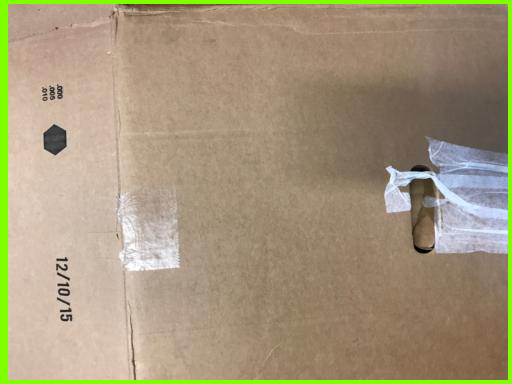

cardboard55_jpg.rf.972a5514673d537391d314157ec808ec.jpg
True


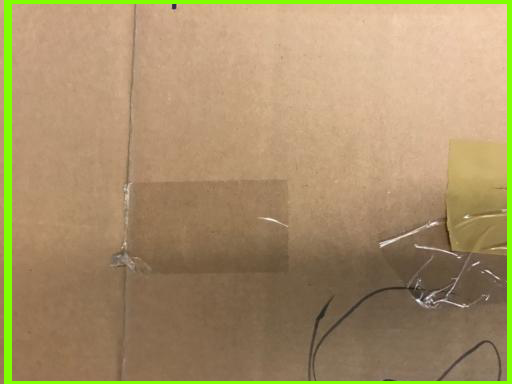

metal247_jpg.rf.857d9b22e07c8e4c2000ea415878308e.jpg
True


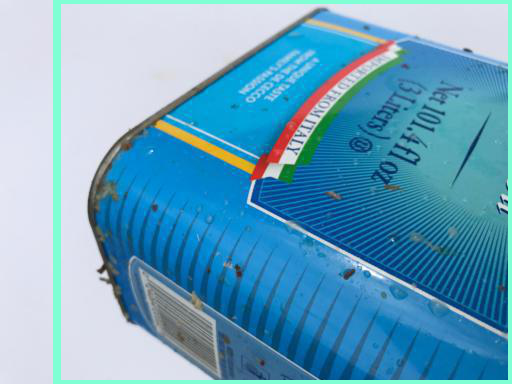

metal227_jpg.rf.5d392e2e300809d6bee39b1fe49523ce.jpg
True


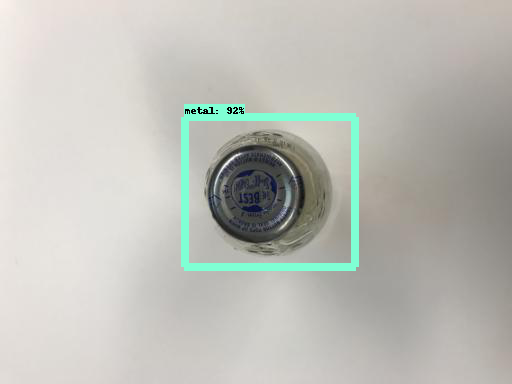

green-glass216_jpg.rf.6266f115781406983410af7cffa190ce.jpg
True


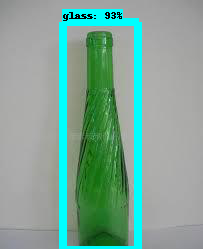

white-glass58_jpg.rf.bcd38150f7d8e251d76ba9fd4fc75471.jpg
True
white-glass58_jpg.rf.bcd38150f7d8e251d76ba9fd4fc75471.jpg
True


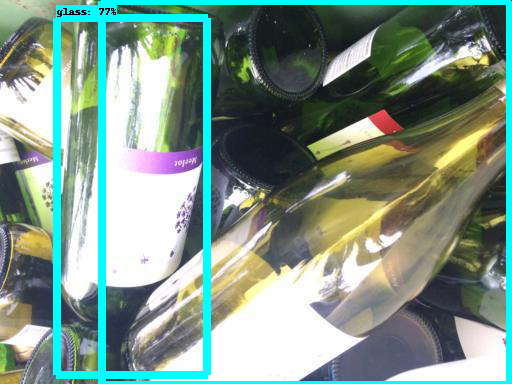

plastic154_jpg.rf.bfb2e9106c4d5b8acc0dbf3458d3f336.jpg
True


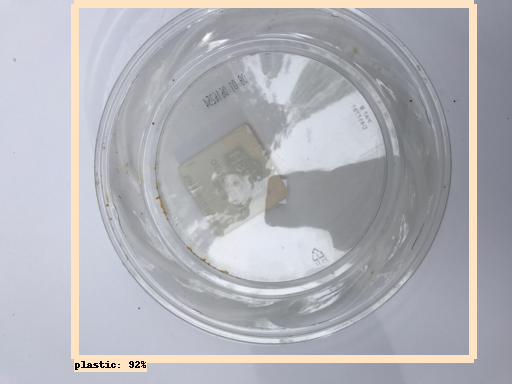

plastic234_jpg.rf.b04e75484133ad91e098296753b3a0e3.jpg
True


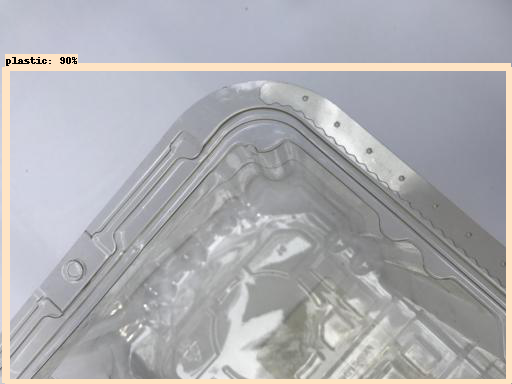

paper861_jpg.rf.5b00be06b8684e83a5f1e914ed7bb12d.jpg
True


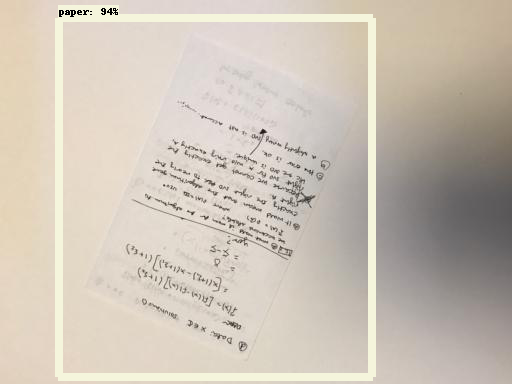

paper964_jpg.rf.05723c3cbc4e142071db3f3f93a4f10b.jpg
True


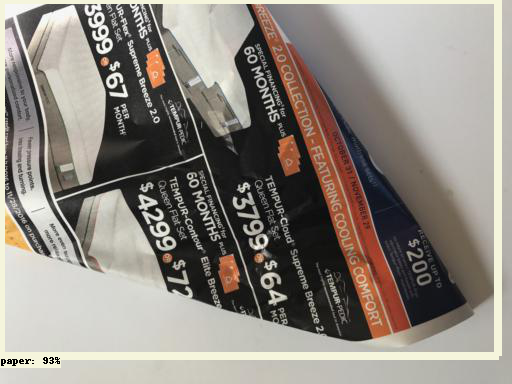

paper908_jpg.rf.232cdcb4820d726dea2b1e0b44508685.jpg
True


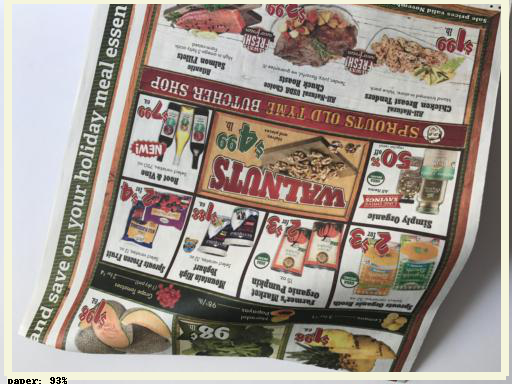

paper980_jpg.rf.6e82afd24496b6c07edd946d25e972bf.jpg
True


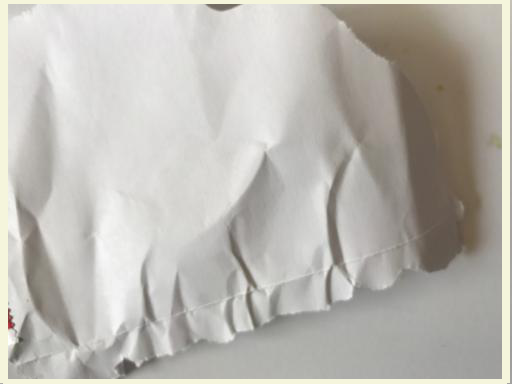

plastic207_jpg.rf.ce354e1b6e43525ad1c9159b531134ff.jpg
True


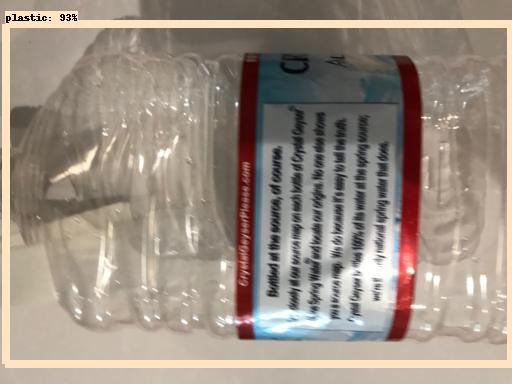

paper806_jpg.rf.4a515e866fb2866e99af51e956648b76.jpg
True


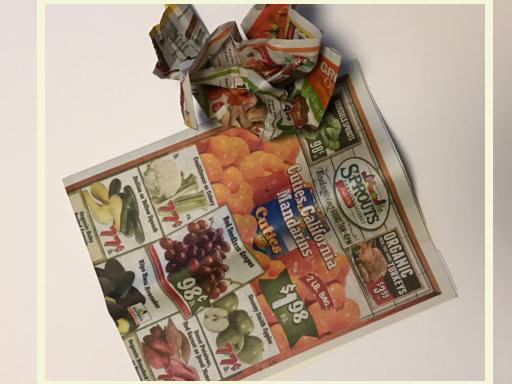

white-glass64_jpg.rf.37deb0e5c152bcd383047277ea0c6602.jpg
True


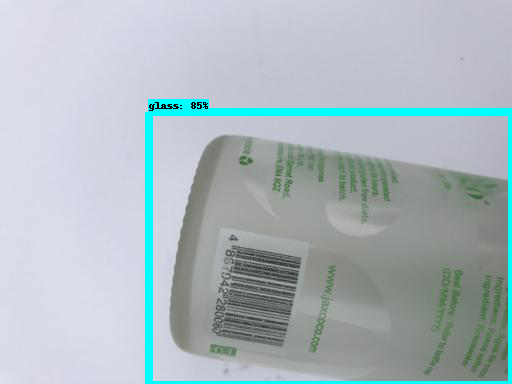

white-glass203_jpg.rf.9f1996c3684ed11931b0938e73e6fdde.jpg
True


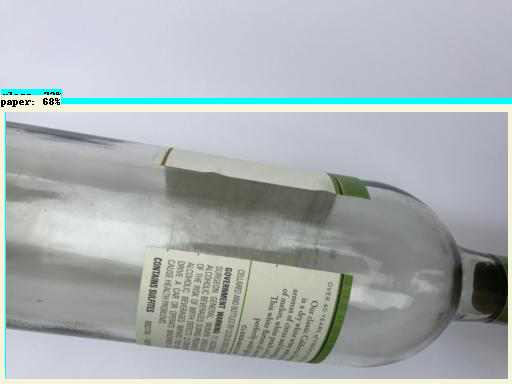

paper818_jpg.rf.2b4099bb3f6290821b9da79e3366c792.jpg
True
paper818_jpg.rf.2b4099bb3f6290821b9da79e3366c792.jpg
True
paper818_jpg.rf.2b4099bb3f6290821b9da79e3366c792.jpg
True
paper818_jpg.rf.2b4099bb3f6290821b9da79e3366c792.jpg
True


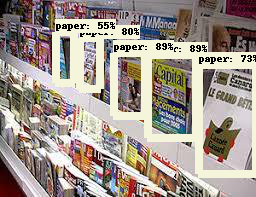

white-glass202_jpg.rf.c3cc57af5f45ac505b98c36963328e26.jpg
True


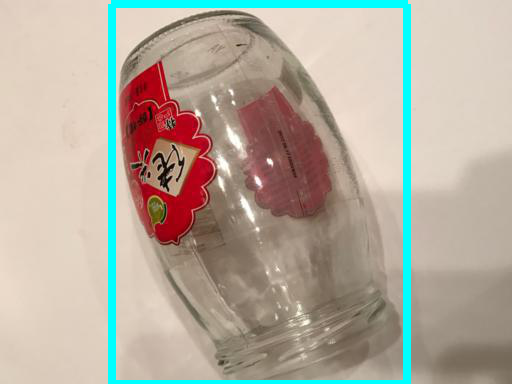

plastic65_jpg.rf.ffe189af55f4fb4c72de01dee227d530.jpg
True
plastic65_jpg.rf.ffe189af55f4fb4c72de01dee227d530.jpg
True


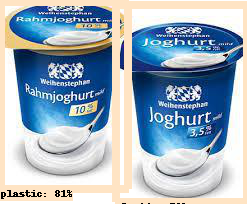

plastic209_jpg.rf.5ec784f40814852340beeaaf14c7a2db.jpg
True


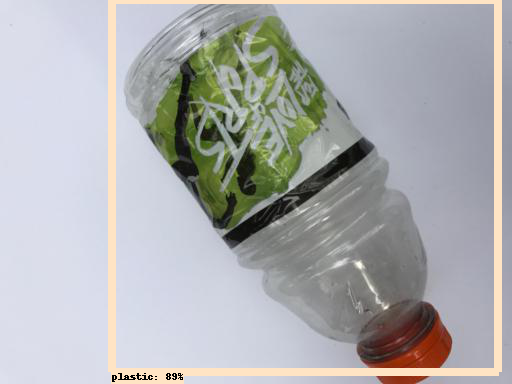

paper961_jpg.rf.bf3079217bd67d96e4f3744ab4b3839b.jpg
True


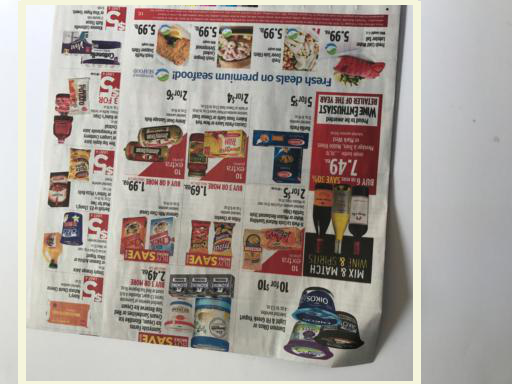

white-glass60_jpg.rf.16acdb232310087b28a1757e12056b70.jpg
True


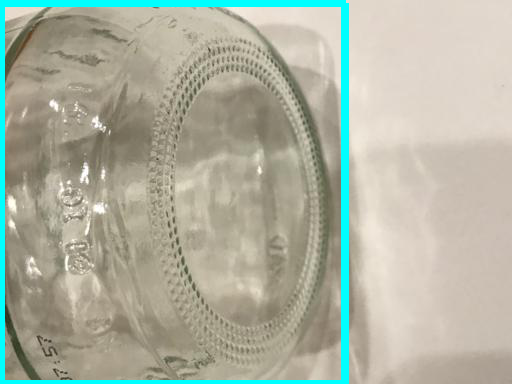

plastic150_jpg.rf.f5bbccb529b4fbd573e9c1b22b57a1e6.jpg
True


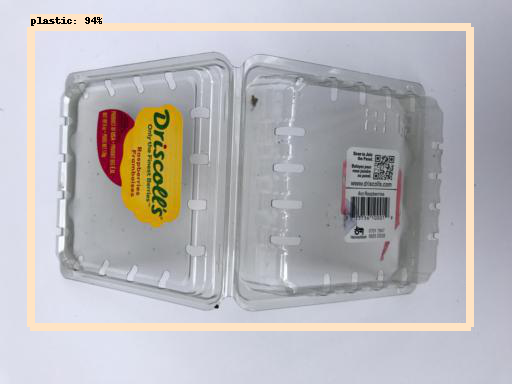

white-glass201_jpg.rf.8a70bb590d18a586572fd328e98be3e4.jpg
True


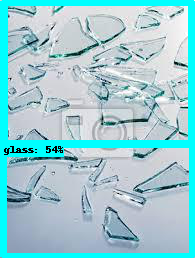

plastic210_jpg.rf.911bc0d5b744fd8d63d78c717538518f.jpg
True


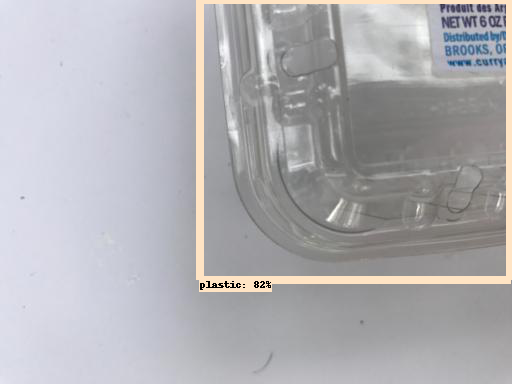

paper802_jpg.rf.d8677df7f6291744a27da4f72933699f.jpg
True


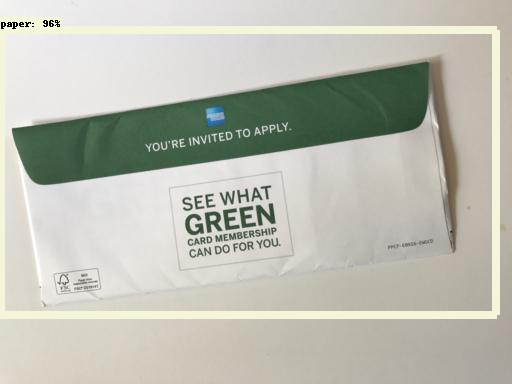

plastic152_jpg.rf.a590774b9a74ab0a61bd07a234874df2.jpg
True


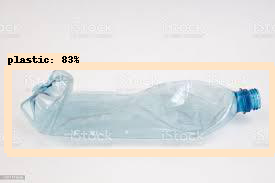

paper999_jpg.rf.52f5f329c5af7da75e3d8795cbdbcbda.jpg
True


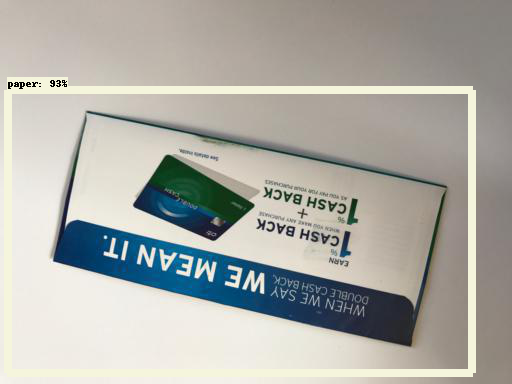

plastic80_jpg.rf.04e4f643ebd4fc130797c86aaedc7f7f.jpg
True


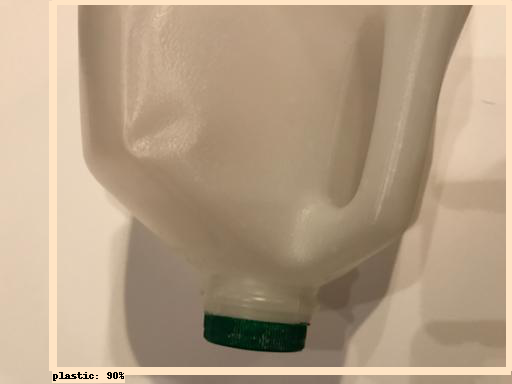

plastic157_jpg.rf.b218bf4356fe14c51b0cda875739cde1.jpg
True
plastic157_jpg.rf.b218bf4356fe14c51b0cda875739cde1.jpg
True
plastic157_jpg.rf.b218bf4356fe14c51b0cda875739cde1.jpg
True


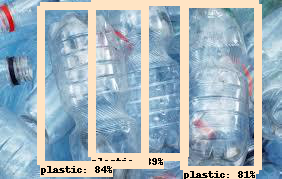

paper902_jpg.rf.fc2f741c4ec32cad2f9108b81064108d.jpg
True


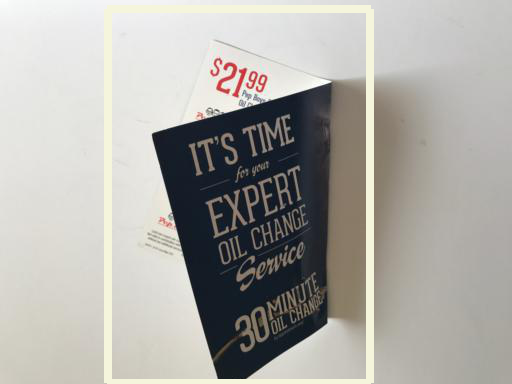

paper843_jpg.rf.752e20fd0a280fa515b56f3424e9b60e.jpg
True


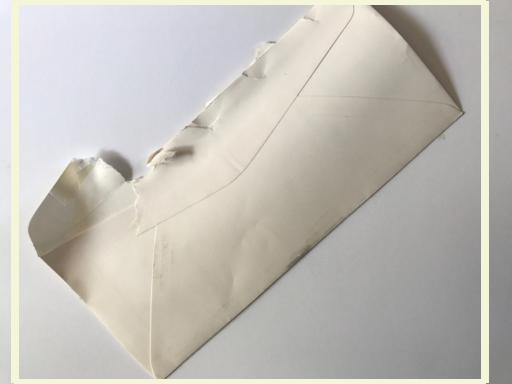

white-glass43_jpg.rf.b4042352d078eb7c3163924f07065ec4.jpg
True


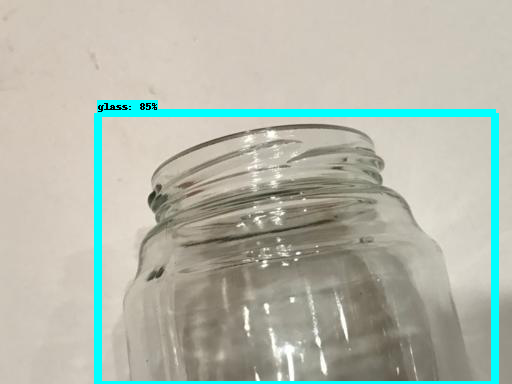

paper859_jpg.rf.e982de7b6ef8bc756450b869cea4db18.jpg
True


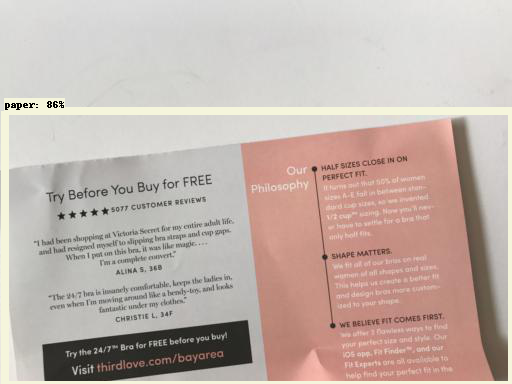

paper828_jpg.rf.e6701ac0efb66b021b55eb888ae4fd67.jpg
True


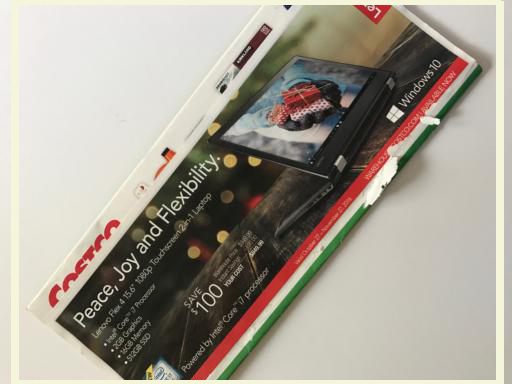

white-glass48_jpg.rf.e9c899fe95d385f4a43c2390b83d3668.jpg
True


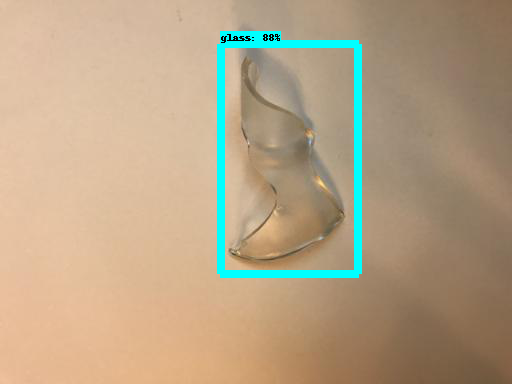

paper860_jpg.rf.ded14f4bf6b3dedc377f6c7b434b02a8.jpg
True


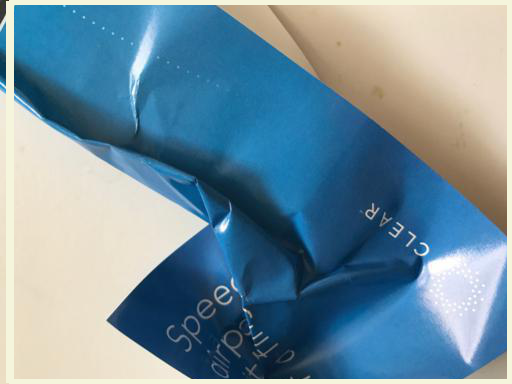

plastic34_jpg.rf.51fc5dc80629aa53ede3a43e2f2d7f9e.jpg
True


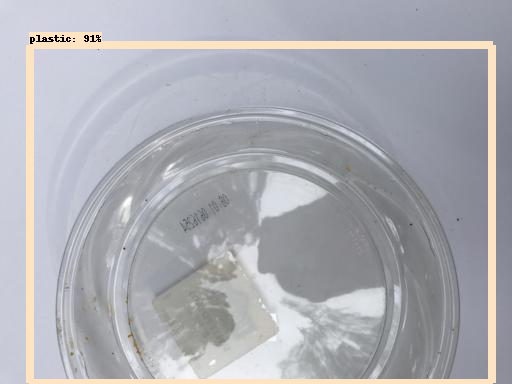

paper927_jpg.rf.9514b74960d4c05a4eef78f7d9186b41.jpg
True


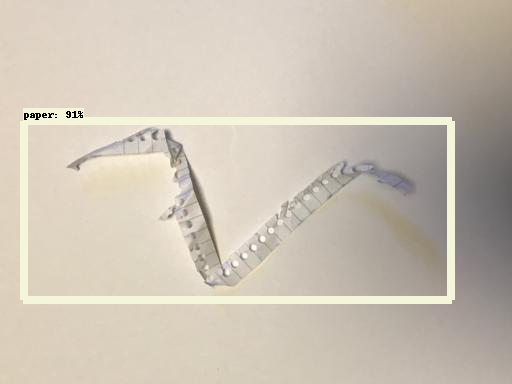

plastic3_jpg.rf.38822473987b65ec39525c7292c7bae2.jpg
True


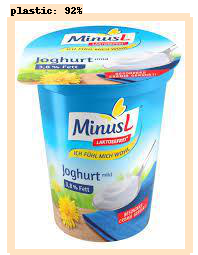

plastic180_jpg.rf.dd9f79376317bf7fbea8c5764ace5f4d.jpg
True


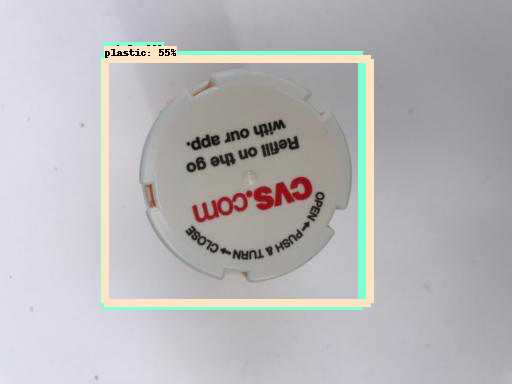

paper875_jpg.rf.ce269ed98e5ab81fb4e1532974bc51cd.jpg
True


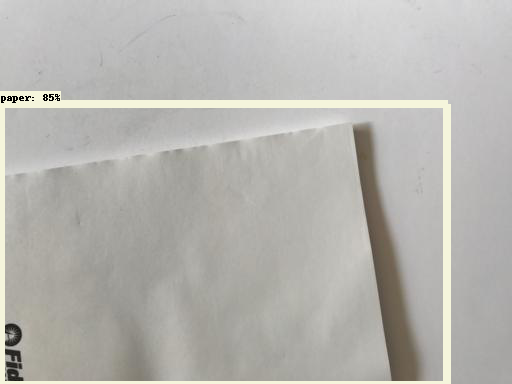

plastic194_jpg.rf.5fb9a0940f9ef86790a543ea43e7f289.jpg
True


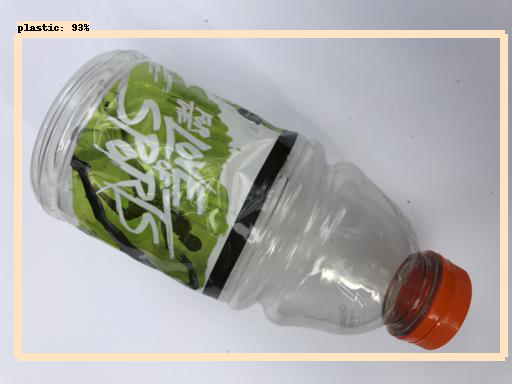

paper811_jpg.rf.a2a18446fe71413b053bd49207bb66ee.jpg
True


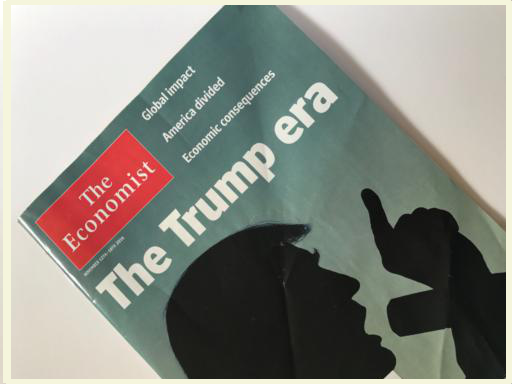

plastic1_jpg.rf.b01fb5ac5ef56d9bdaad42738b09f08e.jpg
True


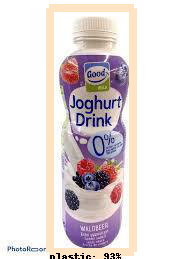

paper825_jpg.rf.a6f9b7f7fb193c313795caa07ca41c96.jpg
True


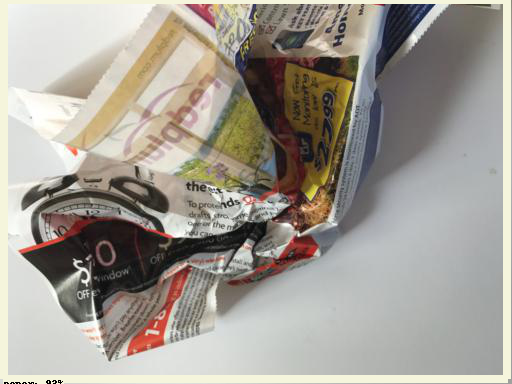

plastic193_jpg.rf.783fb2369c3ca9da8520f39e076bfe8c.jpg
True


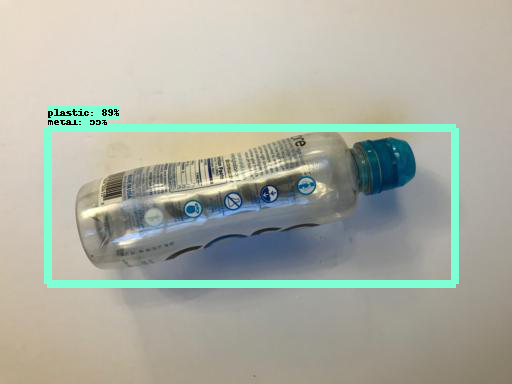

paper867_jpg.rf.30a60d7ddbc5ff07f1b1697c8cf787d7.jpg
True


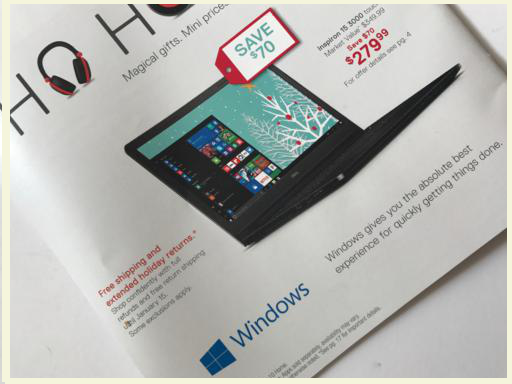

plastic178_jpg.rf.f69ae29eca13a066a684acfff18b8cb9.jpg
True


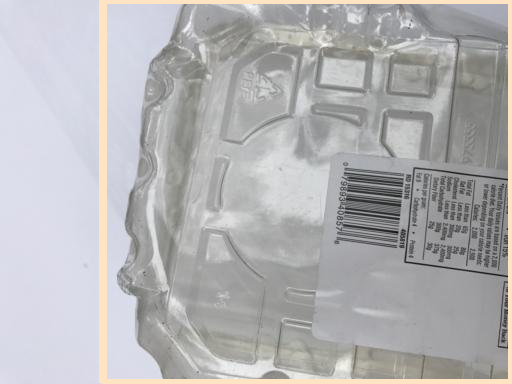

plastic15_jpg.rf.9517ce1fa2fa9834ae033689c8cf0211.jpg
True


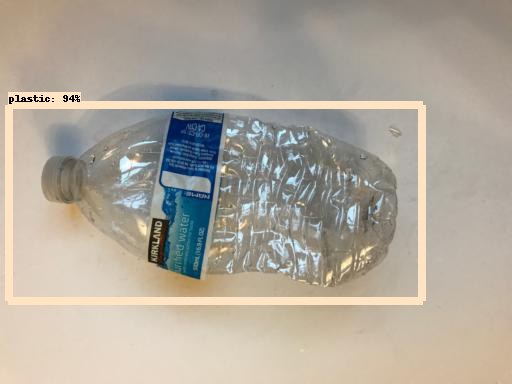

plastic13_jpg.rf.0434e921347ae568f50eb03cdf3c40ce.jpg
True


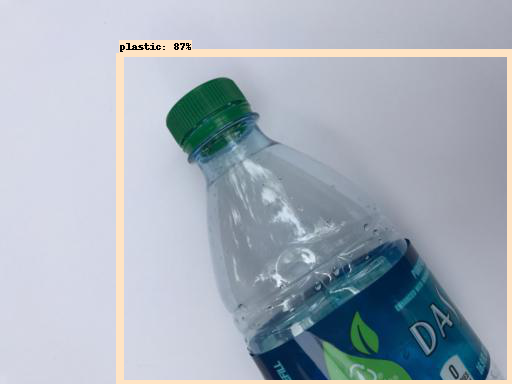

plastic232_jpg.rf.c5cbebfbdc20a7e397201d0eb4a77f23.jpg
True


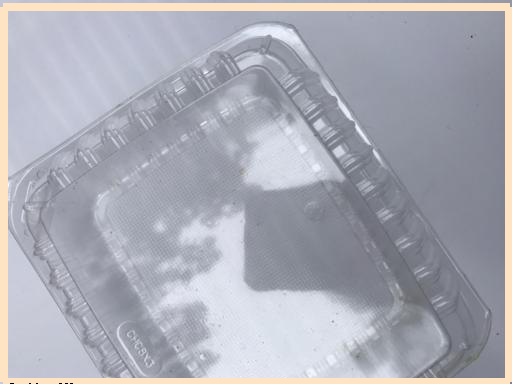

plastic73_jpg.rf.e0cb354ee8fab5942c39f6bc6aa56409.jpg
True


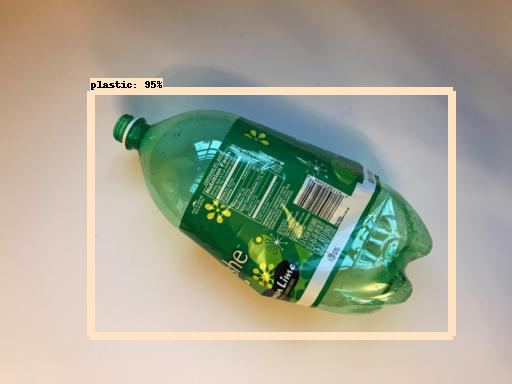

paper918_jpg.rf.03f9fc31b1ce063020a62200ecbe08eb.jpg
True


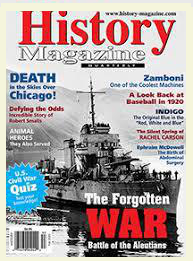

paper882_jpg.rf.8f00645e8a2bdf15ecf3e0995172711c.jpg
True


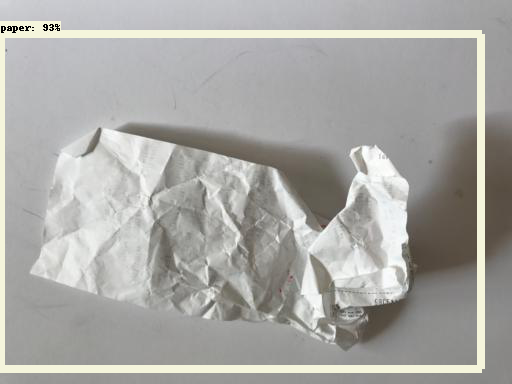

white-glass209_jpg.rf.c505a8a341fdfb0bd8016febbe312230.jpg
True


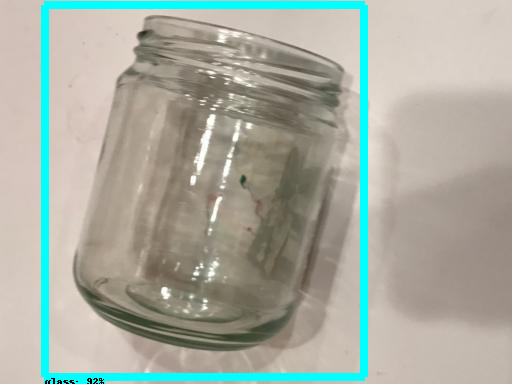

white-glass21_jpg.rf.37633a44716810d45122de1456f8f9be.jpg
True


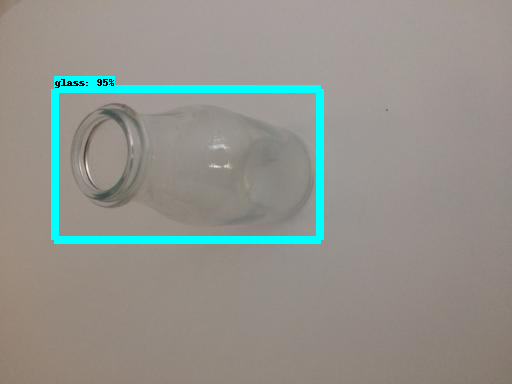

plastic84_jpg.rf.77c9f4a09bd00821b7049352115b2099.jpg
True


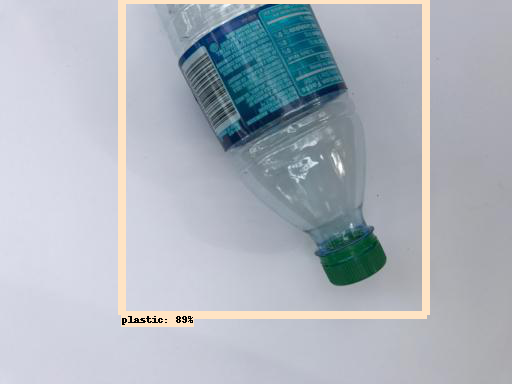

plastic220_jpg.rf.32e6decc5e9224a73150f402490ea7f3.jpg
True


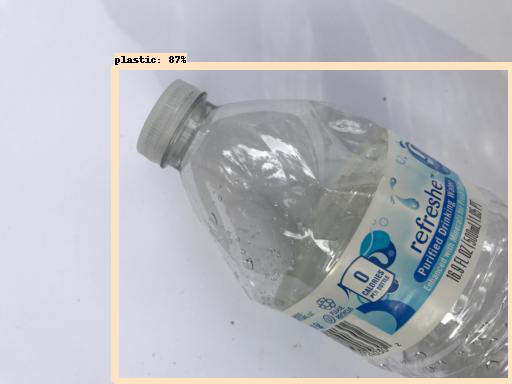

plastic147_jpg.rf.1690259da6bfef1468f7080f22c4382b.jpg
True


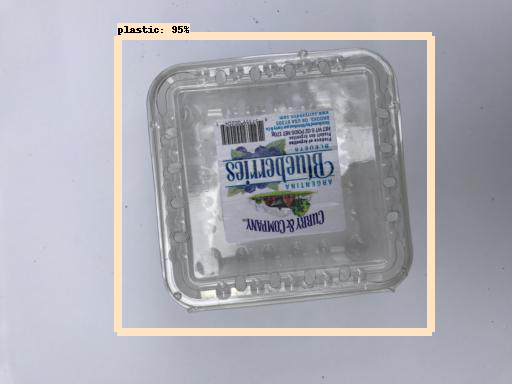

white-glass212_jpg.rf.170ac598afeb67b3b59a9c32d682729b.jpg
True


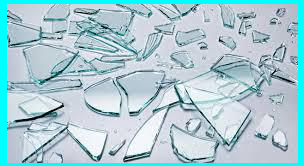

paper822_jpg.rf.bf33f5db7be2a35718686140c4156735.jpg
True


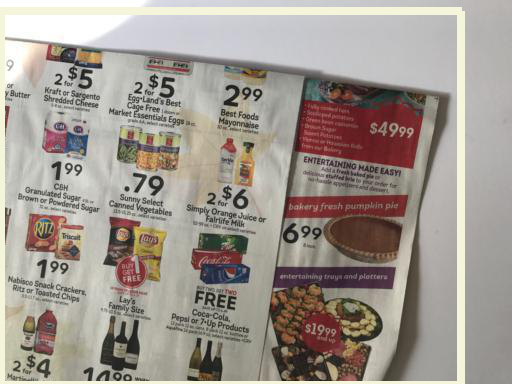

plastic103_jpg.rf.7973c6e315194576e05c19d996cc649c.jpg
True


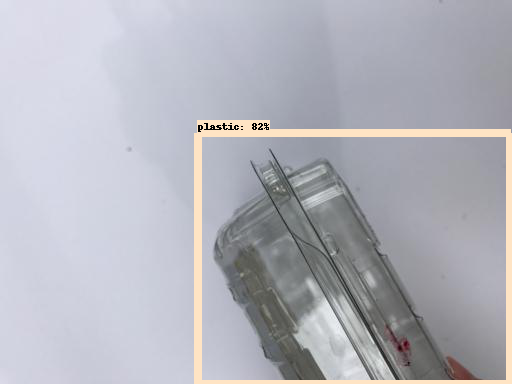

plastic145_jpg.rf.3eef0b3d519b64f2a7926e6c966ccf93.jpg
True


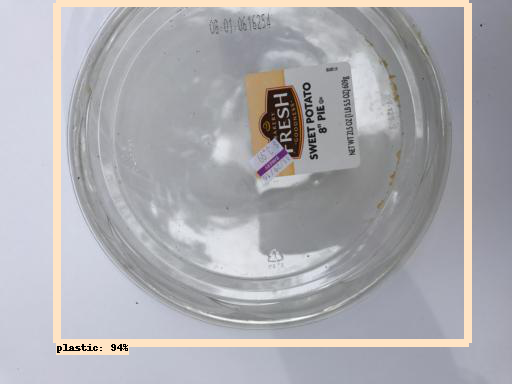

plastic19_jpg.rf.b19da15f63ac4d5d6d3791e9802d3860.jpg
True


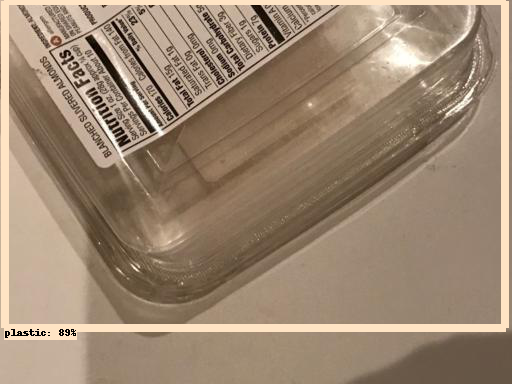

paper922_jpg.rf.03f6d77209bb669dfe6230436471ad93.jpg
True


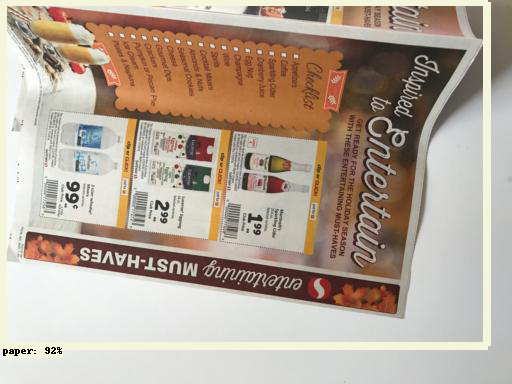

plastic161_jpg.rf.aa82ecd706c943c59a97a0a279e0ca83.jpg
True


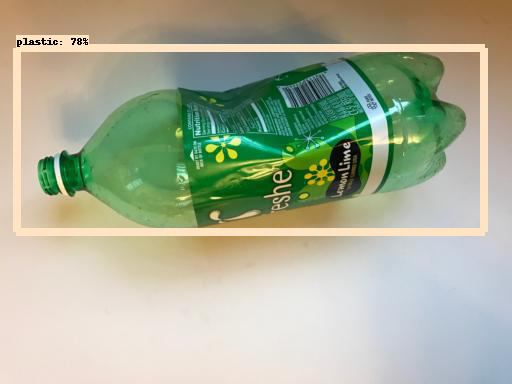

paper905_jpg.rf.15aacccf9ba104f92ad937a17c65f6c1.jpg
True


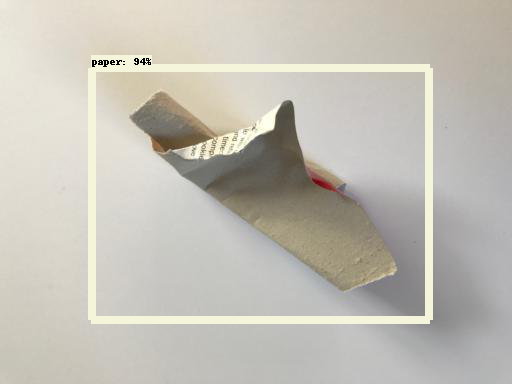

paper945_jpg.rf.7c778da6c63ba73cc1197958721a04a3.jpg
True


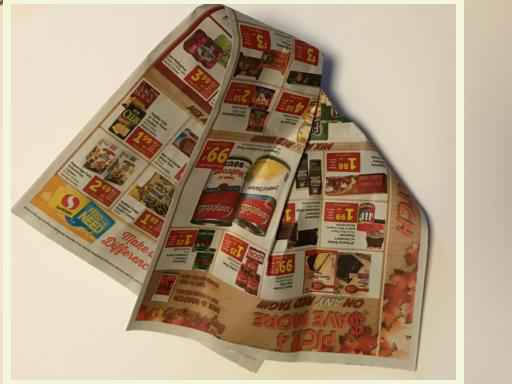

white-glass210_jpg.rf.9d39264aa280ac4966f07ff397943a62.jpg
True


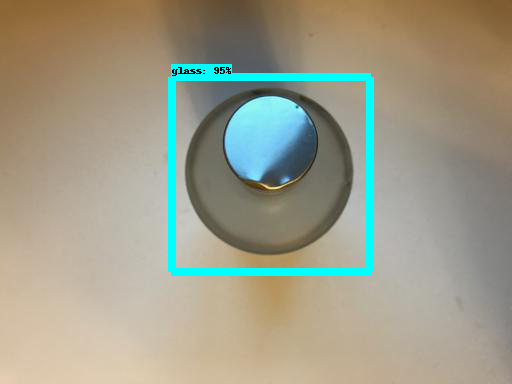

paper906_jpg.rf.c6484b8a46c3800565759d1b9a785e2b.jpg
True


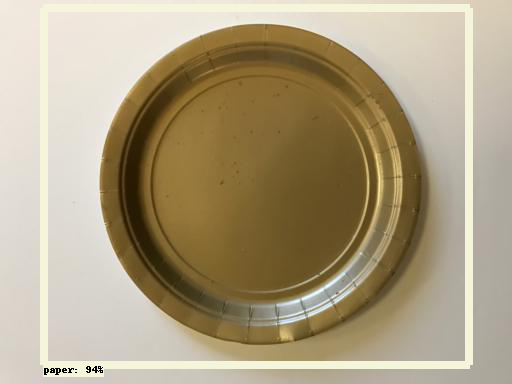

plastic46_jpg.rf.3bce0981e5b7e03c25a749a30f2eb992.jpg
True


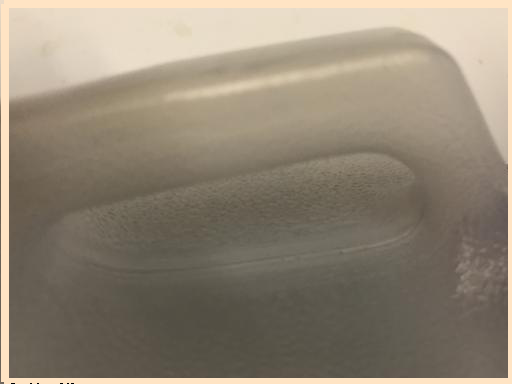

plastic177_jpg.rf.e45b85d9a9733b16846a31958953265a.jpg
True


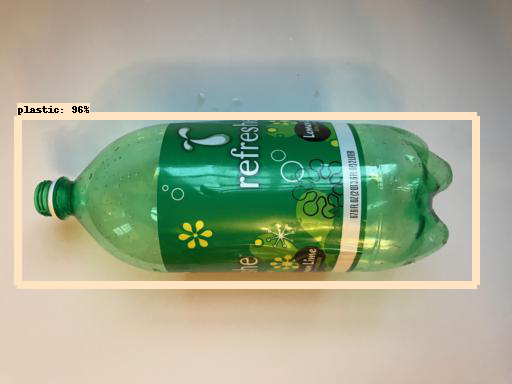

plastic125_jpg.rf.1056ffcf731ed4b0eea062b23c89b99e.jpg
True


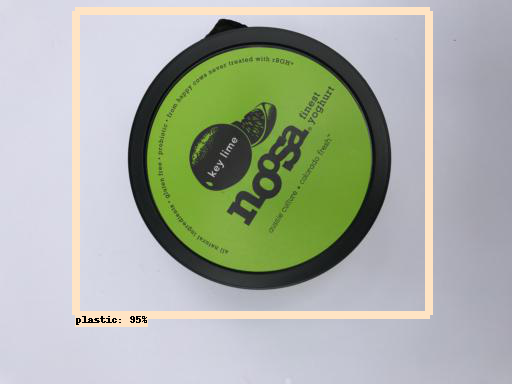

plastic160_jpg.rf.42c467429f54dcdd8cd483eaf6d5c5b7.jpg
True


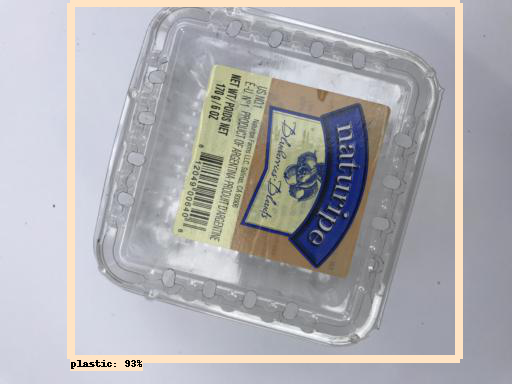

plastic63_jpg.rf.394f6bb328c152fb5359c799a2d8b08a.jpg
True


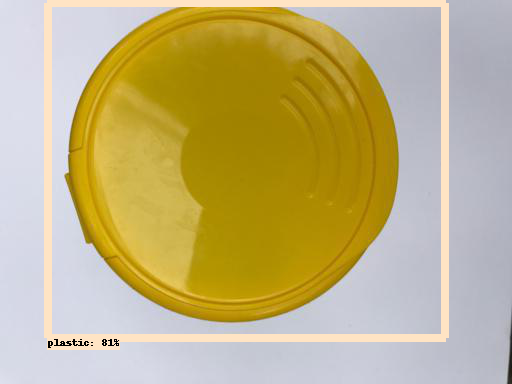

plastic83_jpg.rf.75bb743c307dc1b53378832e9ba17792.jpg
True


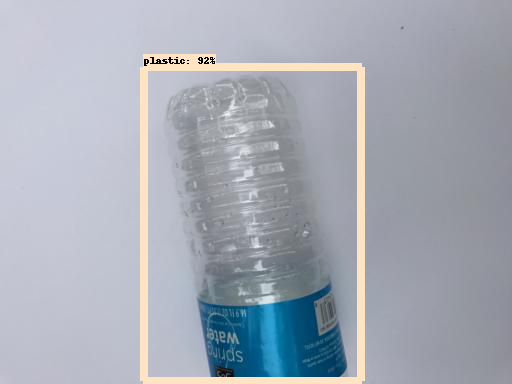

paper801_jpg.rf.8231ae088c4d2723e3f60c3636d035ae.jpg
True


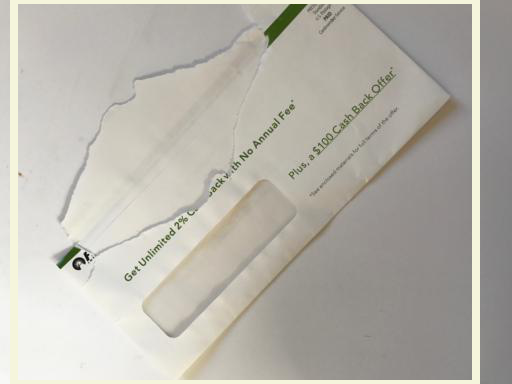

paper994_jpg.rf.ffaf5c5e69e092a619e23464762125ca.jpg
True


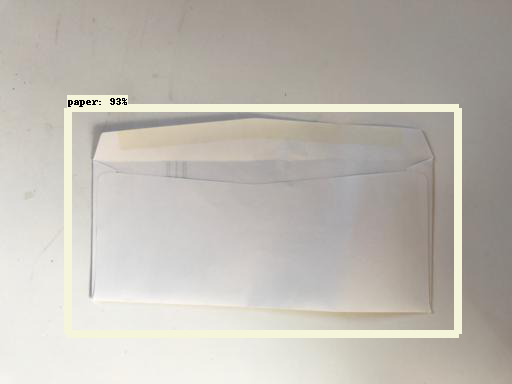

paper834_jpg.rf.49f8332b2cd9f124f20a5ac912a77b0f.jpg
True


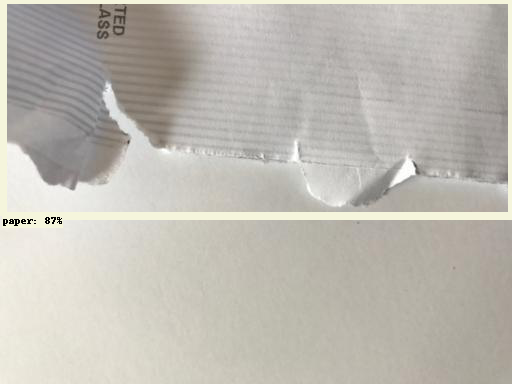

paper868_jpg.rf.cccc25ccc17412ced2221e7f18a7ef5a.jpg
True


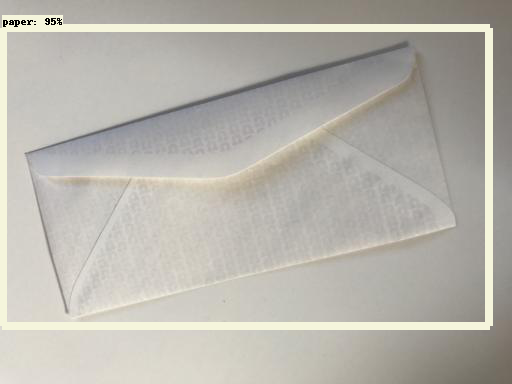

paper812_jpg.rf.9576f997dacbff84509b31b09c49fcd1.jpg
True
paper812_jpg.rf.9576f997dacbff84509b31b09c49fcd1.jpg
True


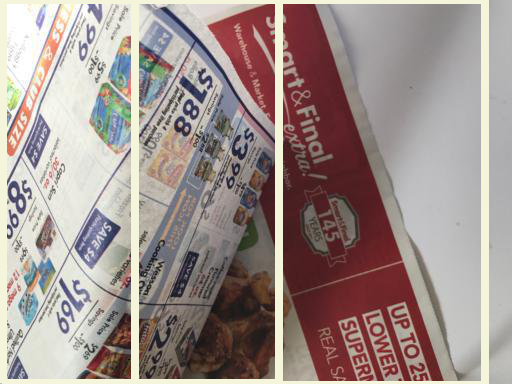

plastic32_jpg.rf.ca6d81f4cff81aa77c481ae885e71a66.jpg
True


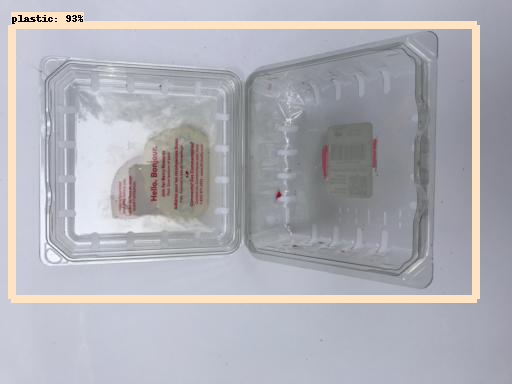

white-glass17_jpg.rf.0a49985b332933231b3ad72beabee701.jpg
True


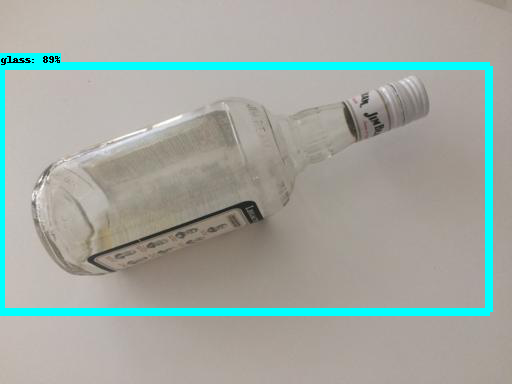

In [ ]:
import ntpath
import pandas as pd
from pathlib import Path
import six


testcsv_path = Path(gdrive_path, 'only_mosaic/test_record/predict_result.csv')

if testcsv_path.is_file():
    f = open(testcsv_path, "w+")
    with open(testcsv_path, 'a', newline='') as file:
        file.truncate(0)
        writer = csv.writer(file)
        writer.writerow(["image_name", "acutal_class", "predicted_class","predicted_confidence","correct"])

    f.close()    
else:
    with open(testcsv_path, 'w', newline = '') as file:
        writer = csv.writer(file)
        writer.writerow(["image_name", "acutal_class", "predicted_class","predicted_confidence","correct"])

predicted_class = [];
predicted_confidence = [];
imgnamelist = [];
acutal_class = [];

for image_path in glob.glob('/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/image/test/*.jpg'):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  if output_dict['detection_classes'][0] in six.viewkeys(category_index):
    result_class = category_index[output_dict['detection_classes'][0]]['name']
    result_confidence = '{}%'.format(int(100 * output_dict['detection_scores'][0]))
    predicted_class.append(result_class)
    predicted_confidence.append(result_confidence)
  imgname = ntpath.basename(image_path)
  imgnamelist.append(imgname)
  test_record_csv = csv.reader(open('/content/drive/MyDrive/GarbageClassification/dataset_withO/only_mosaic/csv/test_tfcsv.csv', "r", encoding='utf-8'), delimiter=",")
  for row in test_record_csv:
    #if current rows 2nd value is equal to input, print that row
    if str(imgname) == str(row[0]):
      print(row[0])
      print(imgname == row[0])
      actualimgclass = row[3]
      acutal_class.append(actualimgclass)
  if actualimgclass == result_class:
    correct = 1
  else:
    correct = 0
  with open(testcsv_path, 'a', newline = '') as file:
    writer = csv.writer(file)
    writer.writerow([imgname, actualimgclass, result_class, result_confidence,correct])
    file.close()

  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))


In [ ]:
# !python /content/models/research/object_detection/model_main_tf2.py \
#     --pipeline_config_path=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/pipeline.config \
#     --model_dir=/content/drive/MyDrive/GarbageClassification/dataset2/data/trained_module/trained_ssd_resnet50 \

In [ ]:
# #install tensorflow 1.15
# !pip install tensorflow==1.15
# #Check tensorflow version
# import tensorflow as tf
# print(tf.__version__)

In [ ]:
# !git clone --q https://github.com/tensorflow/models.git

In [ ]:
# #navigate to /models/research folder to compile protos
# %cd models/research
# # Compile protos.
# !protoc object_detection/protos/*.proto --python_out=.
# # Install TensorFlow Object Detection API.
# !cp object_detection/packages/tf1/setup.py .
# !python -m pip install .

In [ ]:
# !python object_detection/builders/model_builder_tf1_test.py